<a href="https://colab.research.google.com/github/wonjae124/2021_Lab_project/blob/main/(No_earlystop_LRscheduler)moderate_STL_10__DAE.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### 네트워크 드랍아웃, 배치노말라이제이션 순서 : https://gaussian37.github.io/dl-concept-order_of_regularization_term/ 

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Set Dataset and model

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from torchvision import datasets, transforms
from torchvision import utils
from skimage.metrics import structural_similarity as ssim
import math
import cv2
import time
import os


In [3]:
def get_device():
    if torch.cuda.is_available():
        device = 'cuda'
    else:
        device = 'cpu'
    return device


In [4]:
# Define Loss function
def mse_loss(input, target):
    r = input[:,0:1,:,:] - target[:,0:1,:,:]
    g = (input[:,1:2,:,:] - target[:,1:2,:,:])
    b = input[:,2:3,:,:] - target[:,2:3,:,:]
    
    r = torch.mean(r**2)
    g = torch.mean(g**2)
    b = torch.mean(b**2)
    
    mean = (r + g + b)/3
   
    return mean

In [5]:
def Get_psnr(input, output, max_val=1.0):
    """
    Remark
    
    input type : tensor
    output type : float
    """
    input = input.cpu().clone().detach().numpy()
    output = output.cpu().clone().detach().numpy()

 #   print(np.max(input)) check. 1임.
 #   print(np.min(input)) ---> 0
 #   print(np.min(output)) ----> 0

    b = input[:,:,0]
    g = input[:,:,1]
    r = input[:,:,2]

    hat_b = output[:,:,0]
    hat_g = output[:,:,1]
    hat_r = output[:,:,2]

    b_img_diff = hat_b - b
    g_img_diff = hat_g - g 
    r_img_diff = hat_r - r
    
    b_mse = np.mean(b_img_diff**2)
    g_mse = np.mean(g_img_diff**2)
    r_mse = np.mean(r_img_diff**2)

    total_mse = r_mse + g_mse + b_mse
    

    if total_mse == 0:
      return 100
    else:
      psnr = 10 * math.log10( (max_val**2)/total_mse)
      return psnr 

In [15]:
batch_size = 2048
torch.manual_seed(1)
torch.cuda.manual_seed(1)

In [16]:
moderate_transform = transforms.Compose([
                    transforms.ToTensor(),                     
                    transforms.GaussianBlur(kernel_size=(5,5),sigma=3),
])

In [17]:
# 훈련 데이터, 검증 데이터, 테스트 데이터순으로 80,000, 10,000, 8,000


# moderate DataSet

Original Train/Validation/Test dataset

In [18]:
org_tr_set = datasets.STL10(root = "./data", split = "unlabeled", transform = transforms.ToTensor(), download=True)
tr_subset, val_subset = torch.utils.data.random_split(org_tr_set,[80000,20000],generator=torch.Generator().manual_seed(1))
test_set = datasets.STL10(root = "./data", split = "test",transform = transforms.ToTensor(), download=True)



Files already downloaded and verified
Files already downloaded and verified


# PILToTensor와 ToTensor의 차이, 
전자는 정규화를 하지 않는다.
0 부터 255인 uint8(그러므로 나중에 신경망에 넣을 때 float 변환 필요), 후자는 정규화를 하여서 0부터 1인 float가 된다.

단계를 나누어서 이미지에 노이즈를 가해보자

moderate_hat Train/Validation/Test dataset

In [19]:
moderate_hat_tr_set = datasets.STL10(root = "./data", split = "unlabeled", transform = moderate_transform, download=False)
moderate_hat_tr_subset, moderate_hat_val_subset = torch.utils.data.random_split(moderate_hat_tr_set,[80000,20000],generator=torch.Generator().manual_seed(1))
moderate_hat_test_set = datasets.STL10(root = "./data", split = "test",transform = moderate_transform, download=False)

# Original / Gaussian Blur DataLoader

In [20]:
tr_dataloader = DataLoader(tr_subset, batch_size = batch_size, num_workers = 2, pin_memory=True)

val_dataloader = DataLoader(val_subset, batch_size = batch_size, num_workers = 2, pin_memory=True)

test_dataloader = DataLoader(test_set, batch_size = batch_size, num_workers = 2, pin_memory=True)

# Moderate Gaussian Blur DataLoader

In [21]:
moderate_hat_tr_dataloader = DataLoader(moderate_hat_tr_subset, batch_size = batch_size, num_workers = 2, pin_memory=True)
moderate_hat_val_dataloader = DataLoader(moderate_hat_val_subset, batch_size = batch_size, num_workers = 2, pin_memory=True) # 여기서 hat_val_subset을 안 넣는 치명적인 실수.
moderate_hat_test_dataloader = DataLoader(moderate_hat_test_set, batch_size = batch_size, num_workers = 2, pin_memory=True)

# Model. Setting parameter -> float

In [22]:
class DenosingAutoencoder(nn.Module):
  def __init__(self):
    super(DenosingAutoencoder, self).__init__()
    
    self.encoder = nn.Sequential(
    # 96 by 96 by 3
        nn.Conv2d(in_channels = 3, out_channels = 32, kernel_size = 2, stride = 2, padding=0),
        nn.BatchNorm2d(32),
    # 48 by 48 by 32
        nn.ReLU(True),



        nn.Conv2d(in_channels = 32, out_channels = 64, kernel_size = 2, stride = 2, padding = 0),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
    # 24 by 24 by 64  

        nn.Conv2d(in_channels =64, out_channels = 128,  kernel_size = 2, stride = 2, padding=0),
    # 12 by 12 by 128 
        nn.BatchNorm2d(128),
        nn.ReLU(True),


        nn.Conv2d(in_channels = 128, out_channels = 256,  kernel_size = 2, stride = 2, padding=0),
        nn.BatchNorm2d(256),
    # 6 by 6 by 256
        nn.ReLU(True),


        nn.Flatten(start_dim=1),
    )
    self.decoder = nn.Sequential(
        nn.Unflatten(dim=1,unflattened_size = (256,6,6)),
    # 6 by 6 by 256

        nn.ConvTranspose2d(in_channels = 256, out_channels = 128,  kernel_size = 2, stride = 2, padding=0),
        nn.BatchNorm2d(128),
        nn.ReLU(True),

    # 12 by 12 by 128  
        
        nn.ConvTranspose2d(in_channels = 128, out_channels = 64,  kernel_size = 2, stride = 2, padding=0),
        nn.BatchNorm2d(64),
        nn.ReLU(True),


    # 24 by 24 by 64
        nn.ConvTranspose2d(in_channels = 64, out_channels = 32,  kernel_size = 2, stride = 2, padding=0),
        nn.BatchNorm2d(32),
        nn.ReLU(True),   
    
    # 48 by 48 by 32

        nn.ConvTranspose2d(in_channels = 32, out_channels = 3, kernel_size = 2, stride = 2, padding=0),
        nn.BatchNorm2d(3),

    # 96 by 96 by 3
        nn.Sigmoid())
  
  def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded


cuda
Epoch : [1/300] 

Training Loss: 0.043332	 validation Loss 0.036267
PNSR :9.88 	 SSIM : 0.45
PNSR :7.56 	 SSIM : 0.37
PNSR :7.38 	 SSIM : 0.35
PNSR :15.54 	 SSIM : 0.54
PNSR :13.48 	 SSIM : 0.50


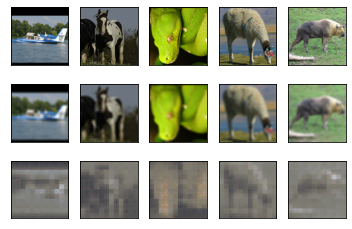

Epoch : [2/300] 

Training Loss: 0.020028	 validation Loss 0.024780
PNSR :11.66 	 SSIM : 0.54
PNSR :9.38 	 SSIM : 0.46
PNSR :8.93 	 SSIM : 0.38
PNSR :17.62 	 SSIM : 0.60
PNSR :15.08 	 SSIM : 0.56


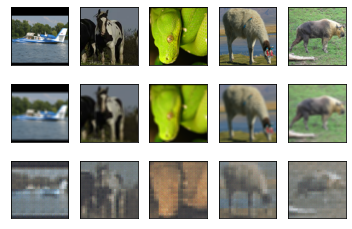

Epoch : [3/300] 

Training Loss: 0.015094	 validation Loss 0.022064
PNSR :11.94 	 SSIM : 0.58
PNSR :9.57 	 SSIM : 0.50
PNSR :9.22 	 SSIM : 0.43
PNSR :18.32 	 SSIM : 0.64
PNSR :15.29 	 SSIM : 0.60


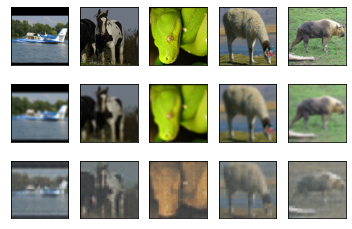

Epoch : [4/300] 

Training Loss: 0.012557	 validation Loss 0.018759
PNSR :12.78 	 SSIM : 0.64
PNSR :10.16 	 SSIM : 0.54
PNSR :9.77 	 SSIM : 0.42
PNSR :18.79 	 SSIM : 0.67
PNSR :15.84 	 SSIM : 0.64


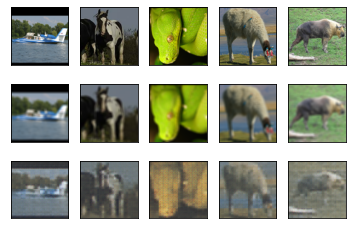

Epoch : [5/300] 

Training Loss: 0.010452	 validation Loss 0.015368
PNSR :13.55 	 SSIM : 0.66
PNSR :11.05 	 SSIM : 0.58
PNSR :10.56 	 SSIM : 0.40
PNSR :19.46 	 SSIM : 0.70
PNSR :17.17 	 SSIM : 0.64


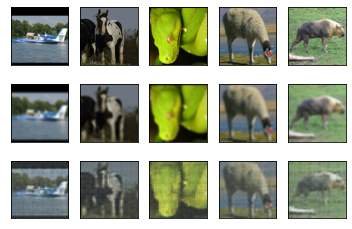

Epoch : [6/300] 

Training Loss: 0.008942	 validation Loss 0.012860
PNSR :14.45 	 SSIM : 0.68
PNSR :11.89 	 SSIM : 0.61
PNSR :12.08 	 SSIM : 0.46
PNSR :20.15 	 SSIM : 0.74
PNSR :17.96 	 SSIM : 0.67


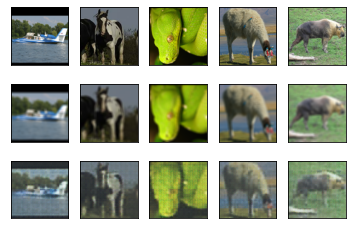

Epoch : [7/300] 

Training Loss: 0.007856	 validation Loss 0.011181
PNSR :15.10 	 SSIM : 0.70
PNSR :12.55 	 SSIM : 0.63
PNSR :12.71 	 SSIM : 0.50
PNSR :20.42 	 SSIM : 0.76
PNSR :18.54 	 SSIM : 0.69


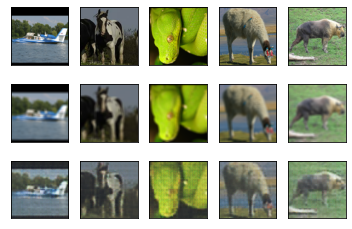

Epoch : [8/300] 

Training Loss: 0.007091	 validation Loss 0.009721
PNSR :15.81 	 SSIM : 0.71
PNSR :13.19 	 SSIM : 0.66
PNSR :13.80 	 SSIM : 0.51
PNSR :20.67 	 SSIM : 0.77
PNSR :18.55 	 SSIM : 0.71


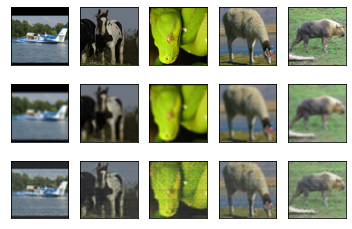

Epoch : [9/300] 

Training Loss: 0.006456	 validation Loss 0.009309
PNSR :15.92 	 SSIM : 0.73
PNSR :13.17 	 SSIM : 0.67
PNSR :14.34 	 SSIM : 0.54
PNSR :20.95 	 SSIM : 0.78
PNSR :18.81 	 SSIM : 0.72


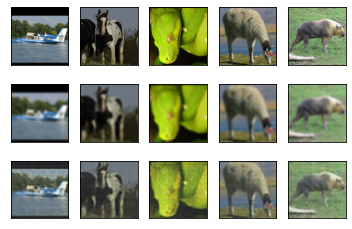

Epoch : [10/300] 

Training Loss: 0.006023	 validation Loss 0.007908
PNSR :17.43 	 SSIM : 0.74
PNSR :14.40 	 SSIM : 0.69
PNSR :15.67 	 SSIM : 0.55
PNSR :21.38 	 SSIM : 0.80
PNSR :19.43 	 SSIM : 0.74


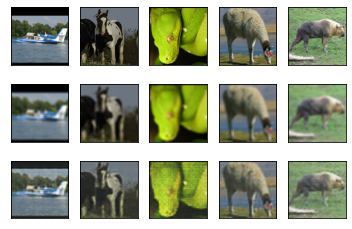

Epoch : [11/300] 

Training Loss: 0.005649	 validation Loss 0.007653
PNSR :17.49 	 SSIM : 0.74
PNSR :14.42 	 SSIM : 0.69
PNSR :15.88 	 SSIM : 0.56
PNSR :21.52 	 SSIM : 0.80
PNSR :19.67 	 SSIM : 0.74


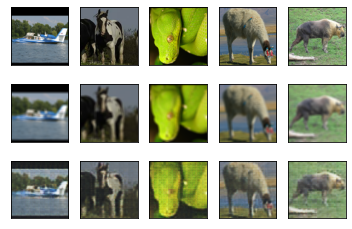

Epoch : [12/300] 

Training Loss: 0.005326	 validation Loss 0.007031
PNSR :17.79 	 SSIM : 0.75
PNSR :14.70 	 SSIM : 0.70
PNSR :16.15 	 SSIM : 0.58
PNSR :22.28 	 SSIM : 0.81
PNSR :19.78 	 SSIM : 0.75


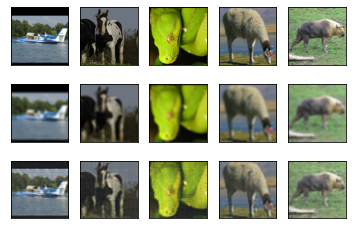

Epoch : [13/300] 

Training Loss: 0.005087	 validation Loss 0.006798
PNSR :18.00 	 SSIM : 0.76
PNSR :14.99 	 SSIM : 0.72
PNSR :16.73 	 SSIM : 0.59
PNSR :22.58 	 SSIM : 0.81
PNSR :20.11 	 SSIM : 0.76


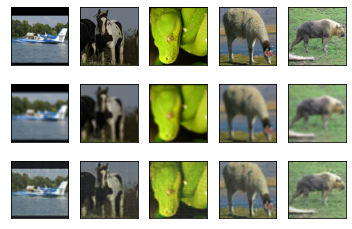

Epoch : [14/300] 

Training Loss: 0.004850	 validation Loss 0.007064
PNSR :18.34 	 SSIM : 0.75
PNSR :15.19 	 SSIM : 0.72
PNSR :15.96 	 SSIM : 0.58
PNSR :22.10 	 SSIM : 0.81
PNSR :19.74 	 SSIM : 0.75


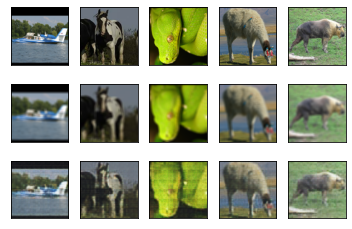

Epoch : [15/300] 

Training Loss: 0.004641	 validation Loss 0.006664
PNSR :18.36 	 SSIM : 0.76
PNSR :15.15 	 SSIM : 0.72
PNSR :16.77 	 SSIM : 0.60
PNSR :22.77 	 SSIM : 0.82
PNSR :20.10 	 SSIM : 0.76


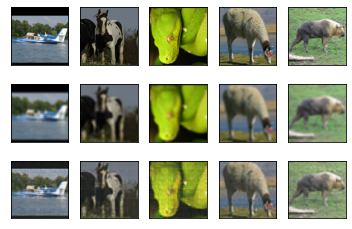

Epoch : [16/300] 

Training Loss: 0.004475	 validation Loss 0.005845
PNSR :19.04 	 SSIM : 0.77
PNSR :15.78 	 SSIM : 0.74
PNSR :17.35 	 SSIM : 0.60
PNSR :22.76 	 SSIM : 0.83
PNSR :20.57 	 SSIM : 0.77


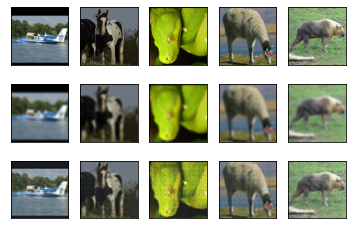

Epoch : [17/300] 

Training Loss: 0.004307	 validation Loss 0.005438
PNSR :19.00 	 SSIM : 0.77
PNSR :15.77 	 SSIM : 0.75
PNSR :17.85 	 SSIM : 0.62
PNSR :22.81 	 SSIM : 0.83
PNSR :20.68 	 SSIM : 0.77


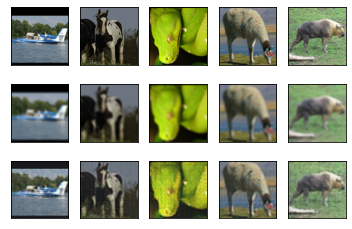

Epoch : [18/300] 

Training Loss: 0.004154	 validation Loss 0.005443
PNSR :19.20 	 SSIM : 0.77
PNSR :16.13 	 SSIM : 0.75
PNSR :17.88 	 SSIM : 0.61
PNSR :22.99 	 SSIM : 0.83
PNSR :20.86 	 SSIM : 0.77


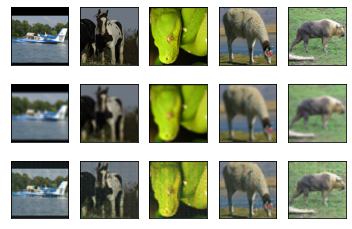

Epoch : [19/300] 

Training Loss: 0.004058	 validation Loss 0.005317
PNSR :19.84 	 SSIM : 0.77
PNSR :16.59 	 SSIM : 0.76
PNSR :19.43 	 SSIM : 0.62
PNSR :22.60 	 SSIM : 0.83
PNSR :20.47 	 SSIM : 0.77


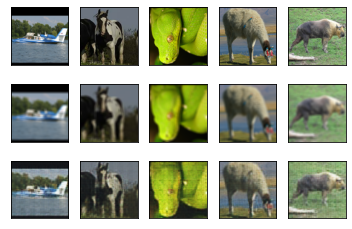

Epoch : [20/300] 

Training Loss: 0.003924	 validation Loss 0.005615
PNSR :19.89 	 SSIM : 0.76
PNSR :16.75 	 SSIM : 0.76
PNSR :18.91 	 SSIM : 0.61
PNSR :22.87 	 SSIM : 0.82
PNSR :20.23 	 SSIM : 0.74


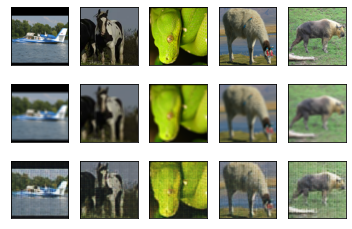

Epoch : [21/300] 

Training Loss: 0.003852	 validation Loss 0.004944
PNSR :19.83 	 SSIM : 0.78
PNSR :16.77 	 SSIM : 0.77
PNSR :18.81 	 SSIM : 0.63
PNSR :22.98 	 SSIM : 0.84
PNSR :20.30 	 SSIM : 0.78


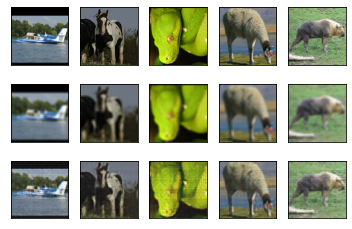

Epoch : [22/300] 

Training Loss: 0.003682	 validation Loss 0.005103
PNSR :19.72 	 SSIM : 0.78
PNSR :16.44 	 SSIM : 0.77
PNSR :19.32 	 SSIM : 0.62
PNSR :22.84 	 SSIM : 0.84
PNSR :20.63 	 SSIM : 0.78


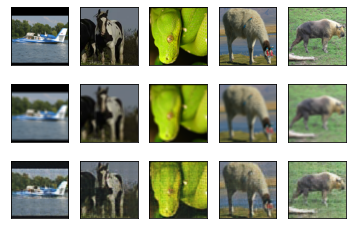

Epoch : [23/300] 

Training Loss: 0.003720	 validation Loss 0.004855
PNSR :20.26 	 SSIM : 0.79
PNSR :16.76 	 SSIM : 0.78
PNSR :18.32 	 SSIM : 0.64
PNSR :22.92 	 SSIM : 0.85
PNSR :20.60 	 SSIM : 0.79


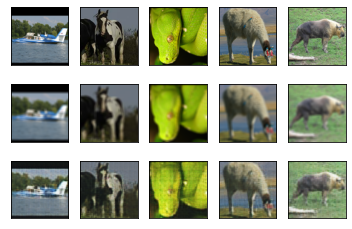

Epoch : [24/300] 

Training Loss: 0.003591	 validation Loss 0.005116
PNSR :20.06 	 SSIM : 0.78
PNSR :17.29 	 SSIM : 0.78
PNSR :20.57 	 SSIM : 0.63
PNSR :22.87 	 SSIM : 0.84
PNSR :20.59 	 SSIM : 0.78


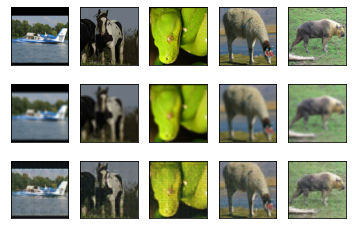

Epoch : [25/300] 

Training Loss: 0.003516	 validation Loss 0.005094
PNSR :20.30 	 SSIM : 0.78
PNSR :17.28 	 SSIM : 0.78
PNSR :20.18 	 SSIM : 0.63
PNSR :23.43 	 SSIM : 0.84
PNSR :20.26 	 SSIM : 0.78


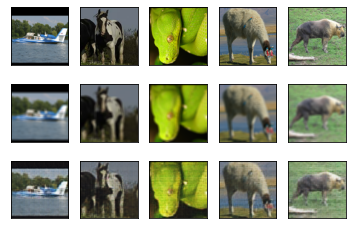

Epoch : [26/300] 

Training Loss: 0.003488	 validation Loss 0.004458
PNSR :20.41 	 SSIM : 0.79
PNSR :17.17 	 SSIM : 0.79
PNSR :19.94 	 SSIM : 0.65
PNSR :23.43 	 SSIM : 0.85
PNSR :21.06 	 SSIM : 0.80


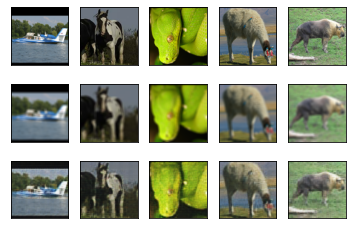

Epoch : [27/300] 

Training Loss: 0.003401	 validation Loss 0.004815
PNSR :20.56 	 SSIM : 0.79
PNSR :17.45 	 SSIM : 0.79
PNSR :19.73 	 SSIM : 0.63
PNSR :23.15 	 SSIM : 0.85
PNSR :20.55 	 SSIM : 0.78


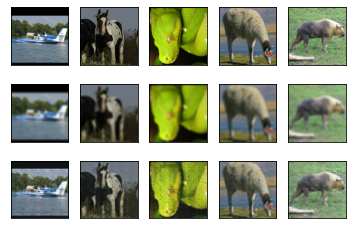

Epoch : [28/300] 

Training Loss: 0.003398	 validation Loss 0.004508
PNSR :20.49 	 SSIM : 0.78
PNSR :17.44 	 SSIM : 0.80
PNSR :20.00 	 SSIM : 0.65
PNSR :23.16 	 SSIM : 0.84
PNSR :20.15 	 SSIM : 0.78


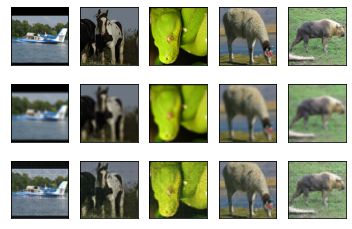

Epoch : [29/300] 

Training Loss: 0.003299	 validation Loss 0.004303
PNSR :20.93 	 SSIM : 0.80
PNSR :17.65 	 SSIM : 0.80
PNSR :21.26 	 SSIM : 0.65
PNSR :23.35 	 SSIM : 0.85
PNSR :21.00 	 SSIM : 0.80


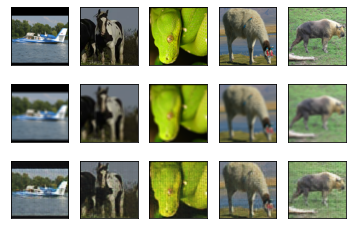

Epoch : [30/300] 

Training Loss: 0.003260	 validation Loss 0.004416
PNSR :20.56 	 SSIM : 0.79
PNSR :17.61 	 SSIM : 0.80
PNSR :21.86 	 SSIM : 0.65
PNSR :23.05 	 SSIM : 0.85
PNSR :21.08 	 SSIM : 0.79


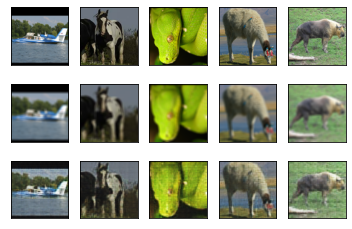

Epoch : [31/300] 

Training Loss: 0.003271	 validation Loss 0.004202
PNSR :21.17 	 SSIM : 0.79
PNSR :18.42 	 SSIM : 0.81
PNSR :22.50 	 SSIM : 0.66
PNSR :22.88 	 SSIM : 0.85
PNSR :20.52 	 SSIM : 0.79


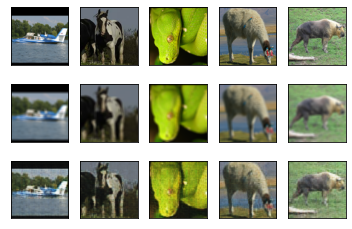

Epoch : [32/300] 

Training Loss: 0.003220	 validation Loss 0.004233
PNSR :20.95 	 SSIM : 0.79
PNSR :17.83 	 SSIM : 0.81
PNSR :21.59 	 SSIM : 0.66
PNSR :23.57 	 SSIM : 0.85
PNSR :20.96 	 SSIM : 0.80


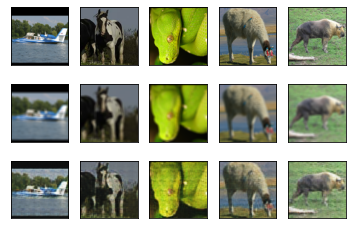

Epoch : [33/300] 

Training Loss: 0.003163	 validation Loss 0.004820
PNSR :20.32 	 SSIM : 0.78
PNSR :17.90 	 SSIM : 0.81
PNSR :20.54 	 SSIM : 0.64
PNSR :23.01 	 SSIM : 0.84
PNSR :20.04 	 SSIM : 0.77


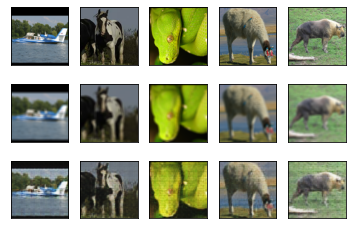

Epoch : [34/300] 

Training Loss: 0.003145	 validation Loss 0.004587
PNSR :20.99 	 SSIM : 0.79
PNSR :17.99 	 SSIM : 0.80
PNSR :20.93 	 SSIM : 0.66
PNSR :23.41 	 SSIM : 0.85
PNSR :20.74 	 SSIM : 0.79


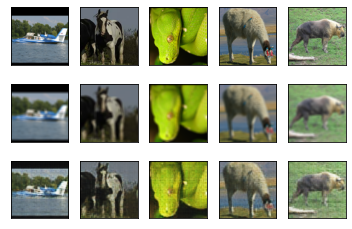

Epoch : [35/300] 

Training Loss: 0.003125	 validation Loss 0.004113
PNSR :20.75 	 SSIM : 0.80
PNSR :17.96 	 SSIM : 0.81
PNSR :21.35 	 SSIM : 0.66
PNSR :23.25 	 SSIM : 0.85
PNSR :20.80 	 SSIM : 0.80


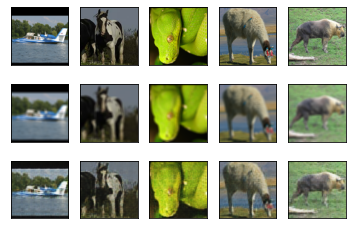

Epoch : [36/300] 

Training Loss: 0.003055	 validation Loss 0.004168
PNSR :20.64 	 SSIM : 0.79
PNSR :18.19 	 SSIM : 0.81
PNSR :21.28 	 SSIM : 0.66
PNSR :22.85 	 SSIM : 0.85
PNSR :20.12 	 SSIM : 0.80


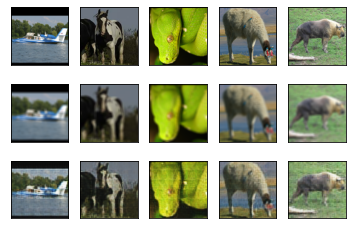

Epoch : [37/300] 

Training Loss: 0.003076	 validation Loss 0.004190
PNSR :21.31 	 SSIM : 0.80
PNSR :18.45 	 SSIM : 0.81
PNSR :20.12 	 SSIM : 0.65
PNSR :23.01 	 SSIM : 0.86
PNSR :20.79 	 SSIM : 0.80


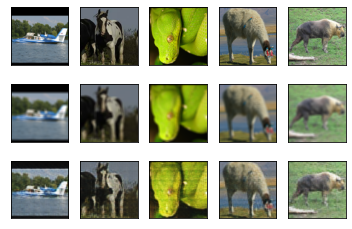

Epoch : [38/300] 

Training Loss: 0.003034	 validation Loss 0.004034
PNSR :21.19 	 SSIM : 0.80
PNSR :18.38 	 SSIM : 0.82
PNSR :20.07 	 SSIM : 0.66
PNSR :22.76 	 SSIM : 0.85
PNSR :20.41 	 SSIM : 0.79


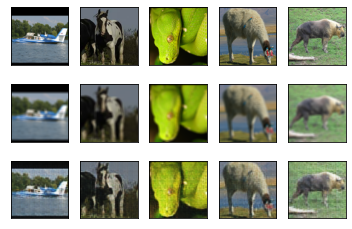

Epoch : [39/300] 

Training Loss: 0.002991	 validation Loss 0.004270
PNSR :20.56 	 SSIM : 0.79
PNSR :18.01 	 SSIM : 0.81
PNSR :18.78 	 SSIM : 0.65
PNSR :22.84 	 SSIM : 0.85
PNSR :19.97 	 SSIM : 0.79


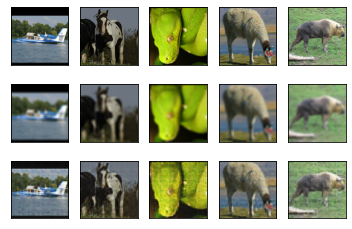

Epoch : [40/300] 

Training Loss: 0.003020	 validation Loss 0.003846
PNSR :21.44 	 SSIM : 0.81
PNSR :18.31 	 SSIM : 0.82
PNSR :20.52 	 SSIM : 0.68
PNSR :23.30 	 SSIM : 0.86
PNSR :20.90 	 SSIM : 0.81


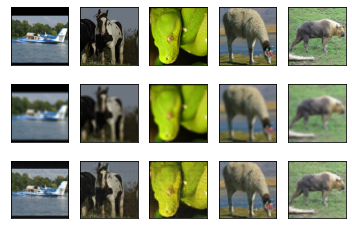

Epoch : [41/300] 

Training Loss: 0.002967	 validation Loss 0.004190
PNSR :20.16 	 SSIM : 0.79
PNSR :17.33 	 SSIM : 0.81
PNSR :17.69 	 SSIM : 0.66
PNSR :22.44 	 SSIM : 0.85
PNSR :20.14 	 SSIM : 0.80


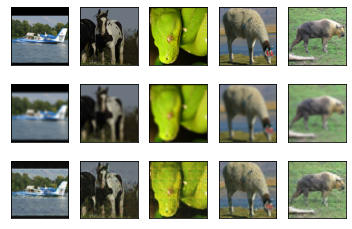

Epoch : [42/300] 

Training Loss: 0.002925	 validation Loss 0.003833
PNSR :21.60 	 SSIM : 0.80
PNSR :19.14 	 SSIM : 0.83
PNSR :19.71 	 SSIM : 0.68
PNSR :23.07 	 SSIM : 0.86
PNSR :20.14 	 SSIM : 0.80


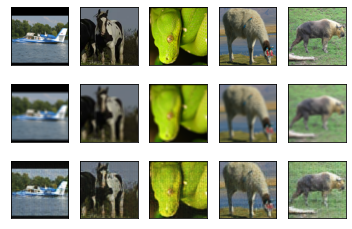

Epoch : [43/300] 

Training Loss: 0.002962	 validation Loss 0.003802
PNSR :22.04 	 SSIM : 0.81
PNSR :19.11 	 SSIM : 0.83
PNSR :22.12 	 SSIM : 0.68
PNSR :23.88 	 SSIM : 0.86
PNSR :21.25 	 SSIM : 0.80


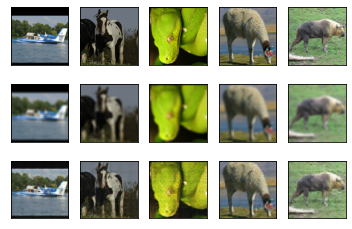

Epoch : [44/300] 

Training Loss: 0.002902	 validation Loss 0.003909
PNSR :21.75 	 SSIM : 0.80
PNSR :19.19 	 SSIM : 0.82
PNSR :20.96 	 SSIM : 0.67
PNSR :23.38 	 SSIM : 0.85
PNSR :20.92 	 SSIM : 0.80


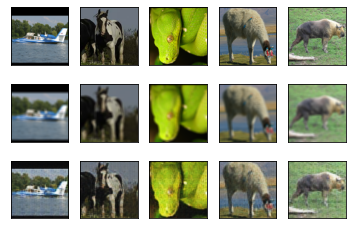

Epoch : [45/300] 

Training Loss: 0.002893	 validation Loss 0.003794
PNSR :21.77 	 SSIM : 0.81
PNSR :19.00 	 SSIM : 0.83
PNSR :21.12 	 SSIM : 0.68
PNSR :23.30 	 SSIM : 0.86
PNSR :20.77 	 SSIM : 0.81


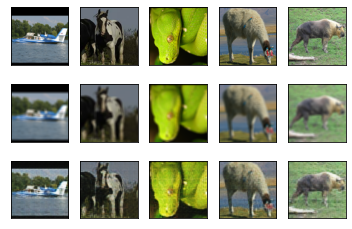

Epoch : [46/300] 

Training Loss: 0.002844	 validation Loss 0.003952
PNSR :21.08 	 SSIM : 0.80
PNSR :18.67 	 SSIM : 0.82
PNSR :20.57 	 SSIM : 0.69
PNSR :23.08 	 SSIM : 0.85
PNSR :20.47 	 SSIM : 0.80


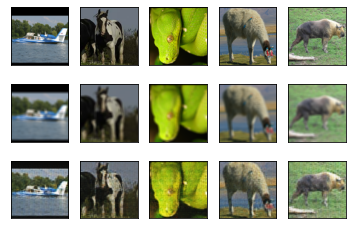

Epoch : [47/300] 

Training Loss: 0.002903	 validation Loss 0.003598
PNSR :22.21 	 SSIM : 0.81
PNSR :19.53 	 SSIM : 0.83
PNSR :20.15 	 SSIM : 0.69
PNSR :23.24 	 SSIM : 0.86
PNSR :21.07 	 SSIM : 0.81


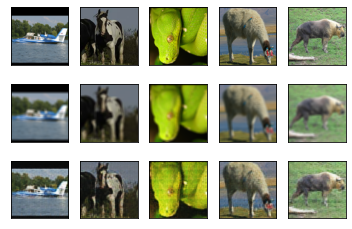

Epoch : [48/300] 

Training Loss: 0.002808	 validation Loss 0.003967
PNSR :21.61 	 SSIM : 0.79
PNSR :19.45 	 SSIM : 0.83
PNSR :21.60 	 SSIM : 0.68
PNSR :22.94 	 SSIM : 0.85
PNSR :20.39 	 SSIM : 0.79


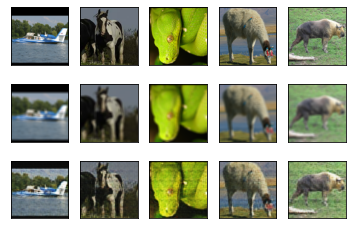

Epoch : [49/300] 

Training Loss: 0.002791	 validation Loss 0.004429
PNSR :20.75 	 SSIM : 0.78
PNSR :18.40 	 SSIM : 0.81
PNSR :19.22 	 SSIM : 0.66
PNSR :22.97 	 SSIM : 0.83
PNSR :20.02 	 SSIM : 0.76


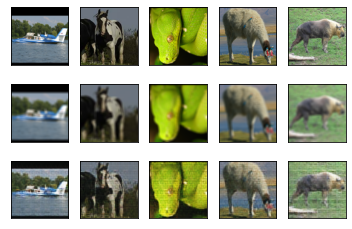

Epoch : [50/300] 

Training Loss: 0.002832	 validation Loss 0.003627
PNSR :22.29 	 SSIM : 0.81
PNSR :20.18 	 SSIM : 0.84
PNSR :21.01 	 SSIM : 0.70
PNSR :23.80 	 SSIM : 0.86
PNSR :21.52 	 SSIM : 0.81


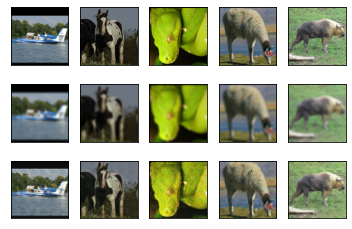

Epoch : [51/300] 

Training Loss: 0.002788	 validation Loss 0.004032
PNSR :21.99 	 SSIM : 0.80
PNSR :19.52 	 SSIM : 0.83
PNSR :22.40 	 SSIM : 0.69
PNSR :23.41 	 SSIM : 0.86
PNSR :21.43 	 SSIM : 0.80


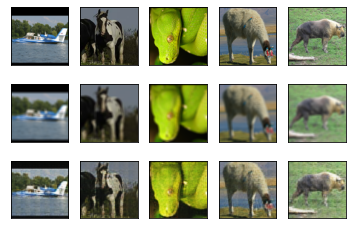

Epoch : [52/300] 

Training Loss: 0.002776	 validation Loss 0.003479
PNSR :22.66 	 SSIM : 0.82
PNSR :19.96 	 SSIM : 0.84
PNSR :22.71 	 SSIM : 0.71
PNSR :23.70 	 SSIM : 0.87
PNSR :21.85 	 SSIM : 0.82


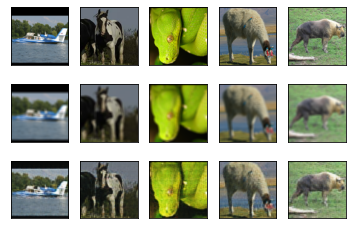

Epoch : [53/300] 

Training Loss: 0.002743	 validation Loss 0.004133
PNSR :21.09 	 SSIM : 0.79
PNSR :18.84 	 SSIM : 0.81
PNSR :19.76 	 SSIM : 0.67
PNSR :23.31 	 SSIM : 0.84
PNSR :20.41 	 SSIM : 0.78


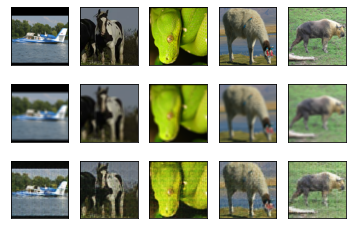

Epoch : [54/300] 

Training Loss: 0.002744	 validation Loss 0.003714
PNSR :22.14 	 SSIM : 0.80
PNSR :19.78 	 SSIM : 0.83
PNSR :22.70 	 SSIM : 0.69
PNSR :23.49 	 SSIM : 0.86
PNSR :21.02 	 SSIM : 0.80


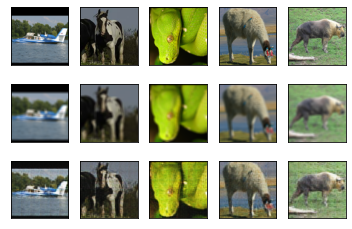

Epoch : [55/300] 

Training Loss: 0.002736	 validation Loss 0.003805
PNSR :21.61 	 SSIM : 0.80
PNSR :19.08 	 SSIM : 0.83
PNSR :19.93 	 SSIM : 0.68
PNSR :23.02 	 SSIM : 0.85
PNSR :21.05 	 SSIM : 0.79


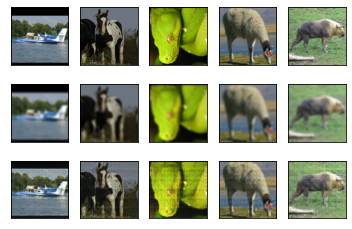

Epoch : [56/300] 

Training Loss: 0.002679	 validation Loss 0.003489
PNSR :22.28 	 SSIM : 0.81
PNSR :19.52 	 SSIM : 0.84
PNSR :21.08 	 SSIM : 0.70
PNSR :23.56 	 SSIM : 0.86
PNSR :21.12 	 SSIM : 0.81


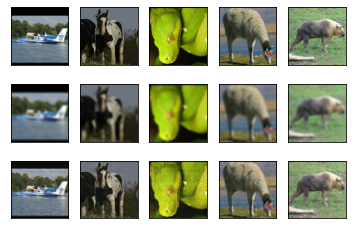

Epoch : [57/300] 

Training Loss: 0.002735	 validation Loss 0.003476
PNSR :22.10 	 SSIM : 0.81
PNSR :19.88 	 SSIM : 0.84
PNSR :21.62 	 SSIM : 0.71
PNSR :23.22 	 SSIM : 0.87
PNSR :21.66 	 SSIM : 0.81


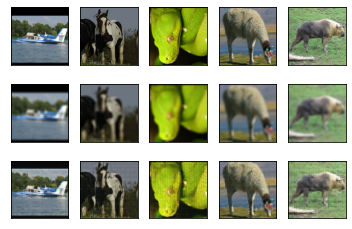

Epoch : [58/300] 

Training Loss: 0.002665	 validation Loss 0.003535
PNSR :22.80 	 SSIM : 0.81
PNSR :20.02 	 SSIM : 0.84
PNSR :23.19 	 SSIM : 0.70
PNSR :24.00 	 SSIM : 0.86
PNSR :21.87 	 SSIM : 0.81


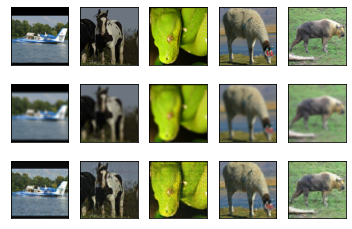

Epoch : [59/300] 

Training Loss: 0.002671	 validation Loss 0.003835
PNSR :21.73 	 SSIM : 0.80
PNSR :19.68 	 SSIM : 0.83
PNSR :21.15 	 SSIM : 0.69
PNSR :23.07 	 SSIM : 0.85
PNSR :20.75 	 SSIM : 0.79


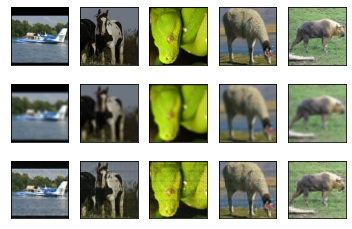

Epoch : [60/300] 

Training Loss: 0.002697	 validation Loss 0.003760
PNSR :22.82 	 SSIM : 0.81
PNSR :20.15 	 SSIM : 0.82
PNSR :22.51 	 SSIM : 0.70
PNSR :23.71 	 SSIM : 0.86
PNSR :21.67 	 SSIM : 0.81


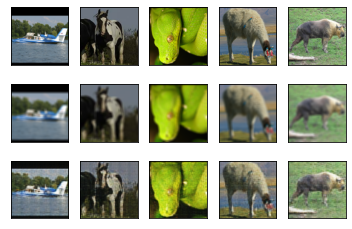

Epoch : [61/300] 

Training Loss: 0.002654	 validation Loss 0.003626
PNSR :22.81 	 SSIM : 0.80
PNSR :20.51 	 SSIM : 0.84
PNSR :22.71 	 SSIM : 0.71
PNSR :23.59 	 SSIM : 0.85
PNSR :20.89 	 SSIM : 0.79


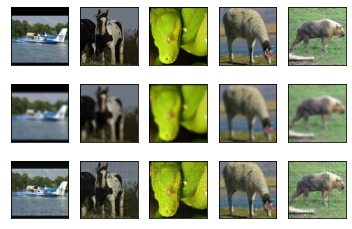

Epoch : [62/300] 

Training Loss: 0.002635	 validation Loss 0.003862
PNSR :22.29 	 SSIM : 0.80
PNSR :19.85 	 SSIM : 0.83
PNSR :22.95 	 SSIM : 0.69
PNSR :22.77 	 SSIM : 0.84
PNSR :21.61 	 SSIM : 0.79


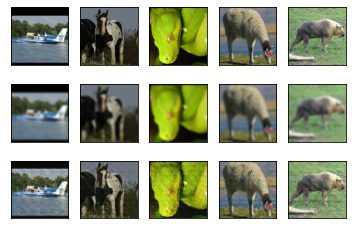

Epoch : [63/300] 

Training Loss: 0.002668	 validation Loss 0.004019
PNSR :21.35 	 SSIM : 0.78
PNSR :19.84 	 SSIM : 0.83
PNSR :22.41 	 SSIM : 0.70
PNSR :23.04 	 SSIM : 0.83
PNSR :20.67 	 SSIM : 0.77


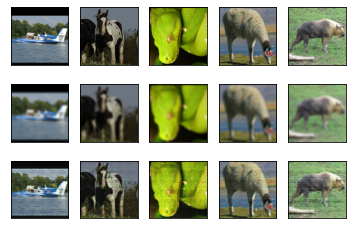

Epoch : [64/300] 

Training Loss: 0.002597	 validation Loss 0.003960
PNSR :21.55 	 SSIM : 0.79
PNSR :19.13 	 SSIM : 0.82
PNSR :21.42 	 SSIM : 0.68
PNSR :22.77 	 SSIM : 0.84
PNSR :20.78 	 SSIM : 0.79


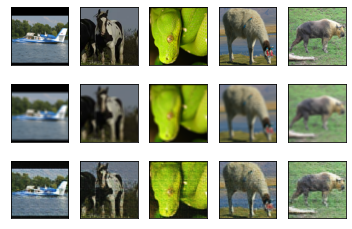

Epoch : [65/300] 

Training Loss: 0.002619	 validation Loss 0.003545
PNSR :23.19 	 SSIM : 0.81
PNSR :20.81 	 SSIM : 0.84
PNSR :24.42 	 SSIM : 0.71
PNSR :23.97 	 SSIM : 0.85
PNSR :21.43 	 SSIM : 0.80


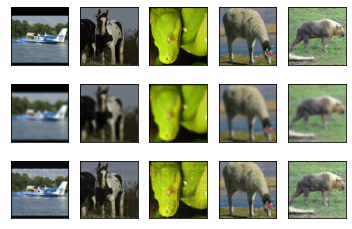

Epoch : [66/300] 

Training Loss: 0.002589	 validation Loss 0.003473
PNSR :22.48 	 SSIM : 0.82
PNSR :20.52 	 SSIM : 0.84
PNSR :24.21 	 SSIM : 0.70
PNSR :23.74 	 SSIM : 0.85
PNSR :21.48 	 SSIM : 0.80


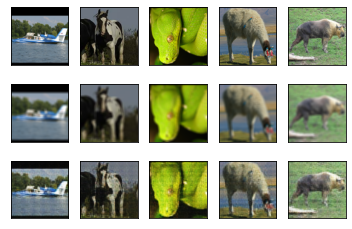

Epoch : [67/300] 

Training Loss: 0.002603	 validation Loss 0.003351
PNSR :22.87 	 SSIM : 0.82
PNSR :21.06 	 SSIM : 0.85
PNSR :24.58 	 SSIM : 0.71
PNSR :23.97 	 SSIM : 0.86
PNSR :22.00 	 SSIM : 0.81


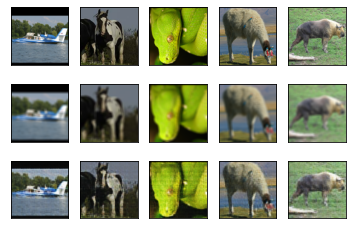

Epoch : [68/300] 

Training Loss: 0.002571	 validation Loss 0.003542
PNSR :22.73 	 SSIM : 0.81
PNSR :20.58 	 SSIM : 0.84
PNSR :22.66 	 SSIM : 0.69
PNSR :22.44 	 SSIM : 0.85
PNSR :21.07 	 SSIM : 0.79


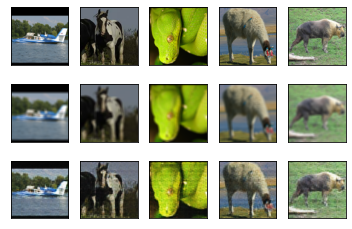

Epoch : [69/300] 

Training Loss: 0.002577	 validation Loss 0.003419
PNSR :22.32 	 SSIM : 0.80
PNSR :20.23 	 SSIM : 0.84
PNSR :23.44 	 SSIM : 0.72
PNSR :23.71 	 SSIM : 0.86
PNSR :21.71 	 SSIM : 0.81


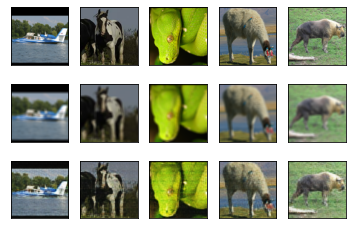

Epoch : [70/300] 

Training Loss: 0.002574	 validation Loss 0.003403
PNSR :22.53 	 SSIM : 0.81
PNSR :20.18 	 SSIM : 0.85
PNSR :23.64 	 SSIM : 0.71
PNSR :23.79 	 SSIM : 0.86
PNSR :21.51 	 SSIM : 0.81


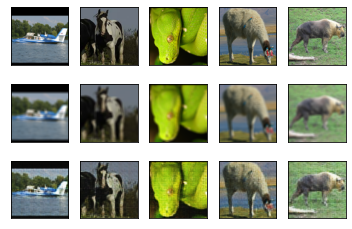

Epoch : [71/300] 

Training Loss: 0.002561	 validation Loss 0.003307
PNSR :22.93 	 SSIM : 0.81
PNSR :20.81 	 SSIM : 0.85
PNSR :23.34 	 SSIM : 0.73
PNSR :22.94 	 SSIM : 0.86
PNSR :21.37 	 SSIM : 0.81


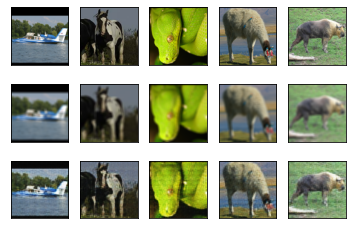

Epoch : [72/300] 

Training Loss: 0.002550	 validation Loss 0.003541
PNSR :22.21 	 SSIM : 0.81
PNSR :20.21 	 SSIM : 0.85
PNSR :22.45 	 SSIM : 0.72
PNSR :23.38 	 SSIM : 0.86
PNSR :21.47 	 SSIM : 0.81


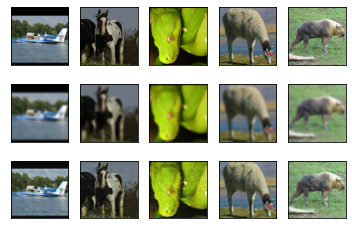

Epoch : [73/300] 

Training Loss: 0.002540	 validation Loss 0.003481
PNSR :22.59 	 SSIM : 0.81
PNSR :20.74 	 SSIM : 0.85
PNSR :23.07 	 SSIM : 0.71
PNSR :23.39 	 SSIM : 0.86
PNSR :21.24 	 SSIM : 0.80


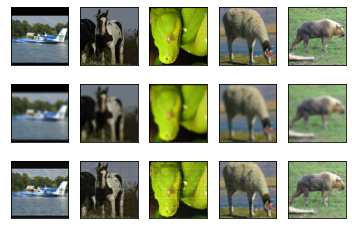

Epoch : [74/300] 

Training Loss: 0.002541	 validation Loss 0.003283
PNSR :23.69 	 SSIM : 0.82
PNSR :21.39 	 SSIM : 0.86
PNSR :25.48 	 SSIM : 0.73
PNSR :23.79 	 SSIM : 0.86
PNSR :21.69 	 SSIM : 0.82


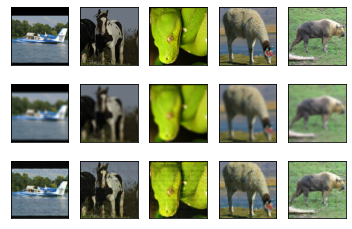

Epoch : [75/300] 

Training Loss: 0.002521	 validation Loss 0.003515
PNSR :22.25 	 SSIM : 0.81
PNSR :20.51 	 SSIM : 0.85
PNSR :23.85 	 SSIM : 0.72
PNSR :23.03 	 SSIM : 0.85
PNSR :21.40 	 SSIM : 0.80


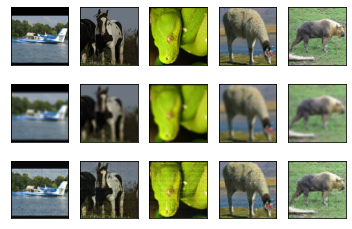

Epoch : [76/300] 

Training Loss: 0.002527	 validation Loss 0.003766
PNSR :21.83 	 SSIM : 0.79
PNSR :19.57 	 SSIM : 0.83
PNSR :21.17 	 SSIM : 0.69
PNSR :23.25 	 SSIM : 0.84
PNSR :20.29 	 SSIM : 0.79


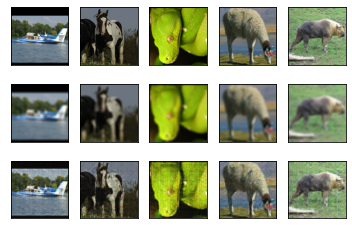

Epoch : [77/300] 

Training Loss: 0.002560	 validation Loss 0.003699
PNSR :22.39 	 SSIM : 0.80
PNSR :20.43 	 SSIM : 0.84
PNSR :22.63 	 SSIM : 0.70
PNSR :22.79 	 SSIM : 0.85
PNSR :21.03 	 SSIM : 0.80


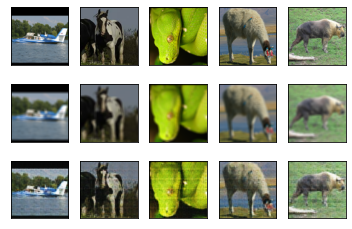

Epoch : [78/300] 

Training Loss: 0.002503	 validation Loss 0.003827
PNSR :21.62 	 SSIM : 0.80
PNSR :19.89 	 SSIM : 0.82
PNSR :22.17 	 SSIM : 0.69
PNSR :21.66 	 SSIM : 0.83
PNSR :20.09 	 SSIM : 0.78


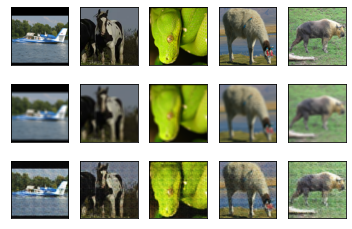

Epoch : [79/300] 

Training Loss: 0.002500	 validation Loss 0.003404
PNSR :22.89 	 SSIM : 0.82
PNSR :20.59 	 SSIM : 0.86
PNSR :23.43 	 SSIM : 0.72
PNSR :24.15 	 SSIM : 0.86
PNSR :21.34 	 SSIM : 0.81


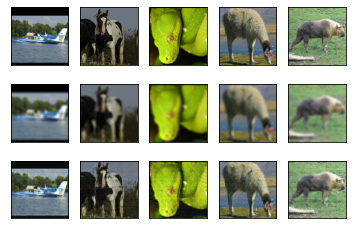

Epoch : [80/300] 

Training Loss: 0.002492	 validation Loss 0.003251
PNSR :22.95 	 SSIM : 0.82
PNSR :20.91 	 SSIM : 0.85
PNSR :24.00 	 SSIM : 0.73
PNSR :23.76 	 SSIM : 0.86
PNSR :21.88 	 SSIM : 0.82


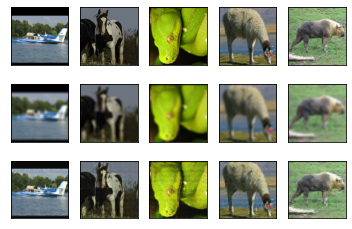

Epoch : [81/300] 

Training Loss: 0.002494	 validation Loss 0.003409
PNSR :23.33 	 SSIM : 0.82
PNSR :21.59 	 SSIM : 0.85
PNSR :24.70 	 SSIM : 0.72
PNSR :24.13 	 SSIM : 0.86
PNSR :22.02 	 SSIM : 0.81


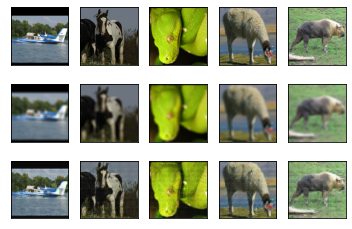

Epoch : [82/300] 

Training Loss: 0.002509	 validation Loss 0.003296
PNSR :23.10 	 SSIM : 0.82
PNSR :20.97 	 SSIM : 0.85
PNSR :24.55 	 SSIM : 0.74
PNSR :23.81 	 SSIM : 0.86
PNSR :22.01 	 SSIM : 0.81


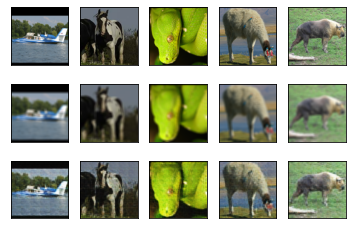

Epoch : [83/300] 

Training Loss: 0.002508	 validation Loss 0.003038
PNSR :22.51 	 SSIM : 0.83
PNSR :20.78 	 SSIM : 0.86
PNSR :24.47 	 SSIM : 0.74
PNSR :23.69 	 SSIM : 0.87
PNSR :21.79 	 SSIM : 0.82


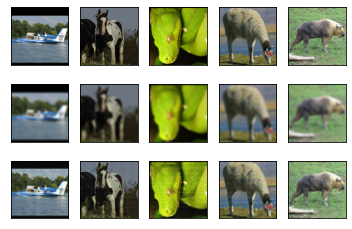

Epoch : [84/300] 

Training Loss: 0.002488	 validation Loss 0.003593
PNSR :23.25 	 SSIM : 0.81
PNSR :20.97 	 SSIM : 0.84
PNSR :24.54 	 SSIM : 0.72
PNSR :23.76 	 SSIM : 0.86
PNSR :21.92 	 SSIM : 0.81


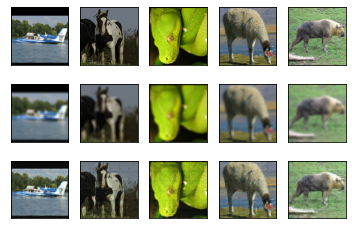

Epoch : [85/300] 

Training Loss: 0.002469	 validation Loss 0.003310
PNSR :24.01 	 SSIM : 0.82
PNSR :21.88 	 SSIM : 0.85
PNSR :25.66 	 SSIM : 0.72
PNSR :23.87 	 SSIM : 0.86
PNSR :22.15 	 SSIM : 0.80


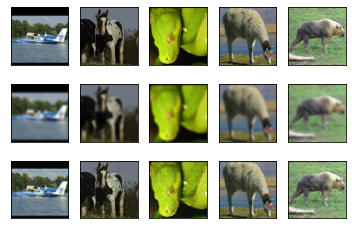

Epoch : [86/300] 

Training Loss: 0.002463	 validation Loss 0.003350
PNSR :22.99 	 SSIM : 0.81
PNSR :21.20 	 SSIM : 0.85
PNSR :23.86 	 SSIM : 0.71
PNSR :23.32 	 SSIM : 0.86
PNSR :21.23 	 SSIM : 0.80


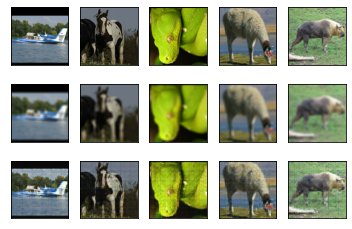

Epoch : [87/300] 

Training Loss: 0.002463	 validation Loss 0.003869
PNSR :22.81 	 SSIM : 0.79
PNSR :21.23 	 SSIM : 0.83
PNSR :23.96 	 SSIM : 0.71
PNSR :22.33 	 SSIM : 0.83
PNSR :20.71 	 SSIM : 0.79


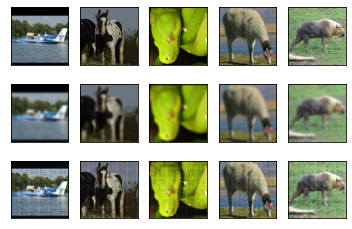

Epoch : [88/300] 

Training Loss: 0.002452	 validation Loss 0.003440
PNSR :22.28 	 SSIM : 0.81
PNSR :20.24 	 SSIM : 0.85
PNSR :23.72 	 SSIM : 0.73
PNSR :23.24 	 SSIM : 0.86
PNSR :20.83 	 SSIM : 0.81


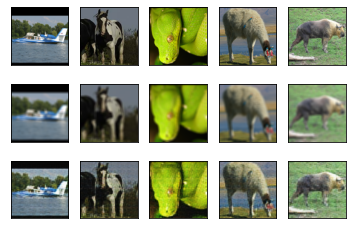

Epoch : [89/300] 

Training Loss: 0.002593	 validation Loss 0.024881
PNSR :12.67 	 SSIM : 0.40
PNSR :12.95 	 SSIM : 0.47
PNSR :16.57 	 SSIM : 0.44
PNSR :11.91 	 SSIM : 0.41
PNSR :11.18 	 SSIM : 0.36


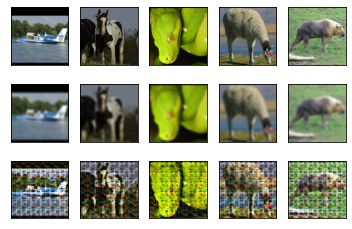

Epoch : [90/300] 

Training Loss: 0.015304	 validation Loss 0.017408
PNSR :15.40 	 SSIM : 0.63
PNSR :14.93 	 SSIM : 0.60
PNSR :14.48 	 SSIM : 0.53
PNSR :14.40 	 SSIM : 0.63
PNSR :13.55 	 SSIM : 0.59


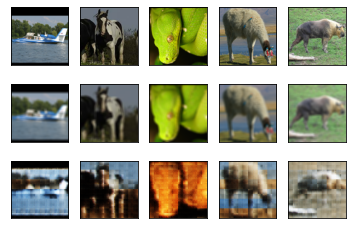

Epoch : [91/300] 

Training Loss: 0.009287	 validation Loss 0.008766
PNSR :19.64 	 SSIM : 0.71
PNSR :16.71 	 SSIM : 0.70
PNSR :17.61 	 SSIM : 0.55
PNSR :20.91 	 SSIM : 0.71
PNSR :16.12 	 SSIM : 0.66


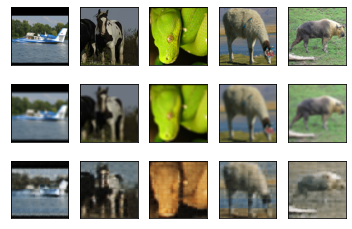

Epoch : [92/300] 

Training Loss: 0.007993	 validation Loss 0.008011
PNSR :20.12 	 SSIM : 0.72
PNSR :16.59 	 SSIM : 0.72
PNSR :18.10 	 SSIM : 0.53
PNSR :20.78 	 SSIM : 0.73
PNSR :16.24 	 SSIM : 0.66


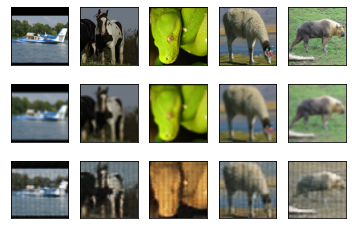

Epoch : [93/300] 

Training Loss: 0.007111	 validation Loss 0.007468
PNSR :19.92 	 SSIM : 0.73
PNSR :17.13 	 SSIM : 0.74
PNSR :18.79 	 SSIM : 0.55
PNSR :21.17 	 SSIM : 0.75
PNSR :16.50 	 SSIM : 0.68


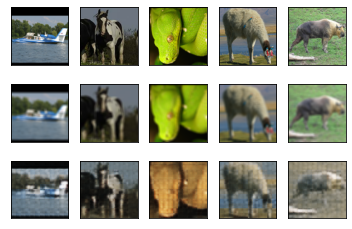

Epoch : [94/300] 

Training Loss: 0.006496	 validation Loss 0.006934
PNSR :20.19 	 SSIM : 0.73
PNSR :17.44 	 SSIM : 0.75
PNSR :18.63 	 SSIM : 0.56
PNSR :21.20 	 SSIM : 0.76
PNSR :16.73 	 SSIM : 0.70


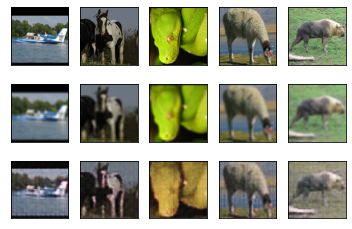

Epoch : [95/300] 

Training Loss: 0.005847	 validation Loss 0.006188
PNSR :20.47 	 SSIM : 0.74
PNSR :17.54 	 SSIM : 0.76
PNSR :18.99 	 SSIM : 0.62
PNSR :21.37 	 SSIM : 0.78
PNSR :19.06 	 SSIM : 0.70


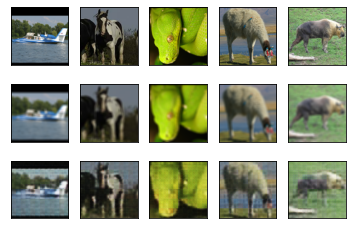

Epoch : [96/300] 

Training Loss: 0.005526	 validation Loss 0.006241
PNSR :20.43 	 SSIM : 0.74
PNSR :17.48 	 SSIM : 0.77
PNSR :18.85 	 SSIM : 0.63
PNSR :20.54 	 SSIM : 0.78
PNSR :18.88 	 SSIM : 0.71


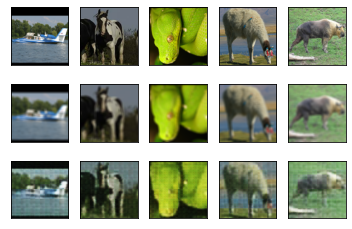

Epoch : [97/300] 

Training Loss: 0.005251	 validation Loss 0.005919
PNSR :20.65 	 SSIM : 0.74
PNSR :17.84 	 SSIM : 0.77
PNSR :18.41 	 SSIM : 0.63
PNSR :20.59 	 SSIM : 0.78
PNSR :19.09 	 SSIM : 0.71


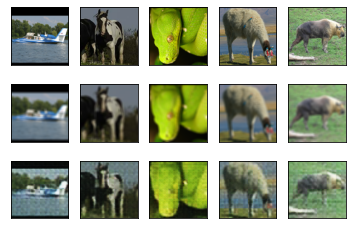

Epoch : [98/300] 

Training Loss: 0.004940	 validation Loss 0.005614
PNSR :20.36 	 SSIM : 0.75
PNSR :18.27 	 SSIM : 0.79
PNSR :19.15 	 SSIM : 0.65
PNSR :20.82 	 SSIM : 0.79
PNSR :19.09 	 SSIM : 0.73


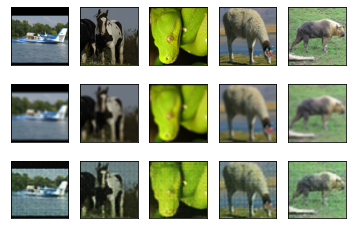

Epoch : [99/300] 

Training Loss: 0.004748	 validation Loss 0.005435
PNSR :20.68 	 SSIM : 0.76
PNSR :18.27 	 SSIM : 0.80
PNSR :19.10 	 SSIM : 0.65
PNSR :20.86 	 SSIM : 0.80
PNSR :18.96 	 SSIM : 0.73


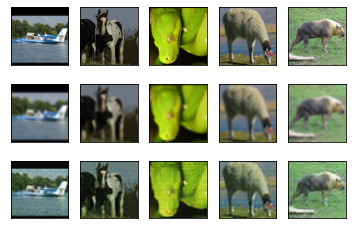

Epoch : [100/300] 

Training Loss: 0.004494	 validation Loss 0.005157
PNSR :21.34 	 SSIM : 0.77
PNSR :18.77 	 SSIM : 0.81
PNSR :19.26 	 SSIM : 0.67
PNSR :21.54 	 SSIM : 0.81
PNSR :19.66 	 SSIM : 0.74


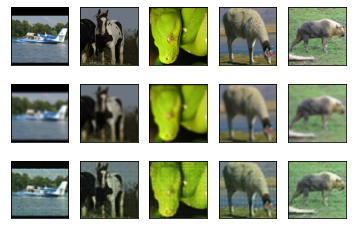

Epoch : [101/300] 

Training Loss: 0.004406	 validation Loss 0.005329
PNSR :20.86 	 SSIM : 0.76
PNSR :18.42 	 SSIM : 0.80
PNSR :18.71 	 SSIM : 0.65
PNSR :21.18 	 SSIM : 0.79
PNSR :19.37 	 SSIM : 0.74


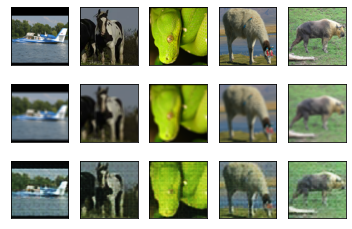

Epoch : [102/300] 

Training Loss: 0.004297	 validation Loss 0.005051
PNSR :21.46 	 SSIM : 0.77
PNSR :18.87 	 SSIM : 0.81
PNSR :20.27 	 SSIM : 0.67
PNSR :21.47 	 SSIM : 0.81
PNSR :19.38 	 SSIM : 0.75


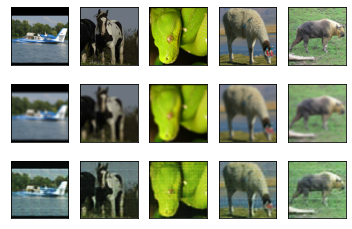

Epoch : [103/300] 

Training Loss: 0.004200	 validation Loss 0.004936
PNSR :21.74 	 SSIM : 0.78
PNSR :19.08 	 SSIM : 0.81
PNSR :20.35 	 SSIM : 0.68
PNSR :21.45 	 SSIM : 0.81
PNSR :19.82 	 SSIM : 0.75


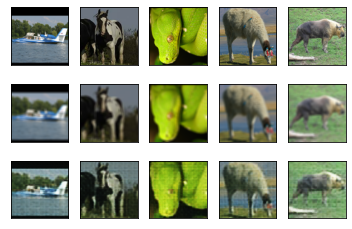

Epoch : [104/300] 

Training Loss: 0.004148	 validation Loss 0.004975
PNSR :21.78 	 SSIM : 0.77
PNSR :19.34 	 SSIM : 0.81
PNSR :20.47 	 SSIM : 0.67
PNSR :21.52 	 SSIM : 0.81
PNSR :19.76 	 SSIM : 0.75


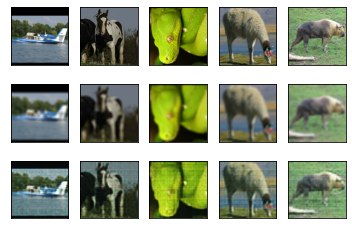

Epoch : [105/300] 

Training Loss: 0.004091	 validation Loss 0.005085
PNSR :21.16 	 SSIM : 0.77
PNSR :19.21 	 SSIM : 0.81
PNSR :20.61 	 SSIM : 0.68
PNSR :20.96 	 SSIM : 0.80
PNSR :19.12 	 SSIM : 0.74


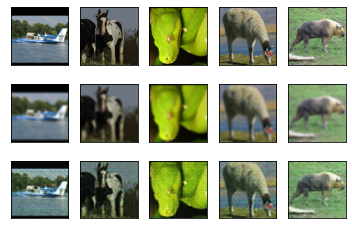

Epoch : [106/300] 

Training Loss: 0.003990	 validation Loss 0.005044
PNSR :21.81 	 SSIM : 0.78
PNSR :19.26 	 SSIM : 0.82
PNSR :21.00 	 SSIM : 0.68
PNSR :21.07 	 SSIM : 0.81
PNSR :19.69 	 SSIM : 0.75


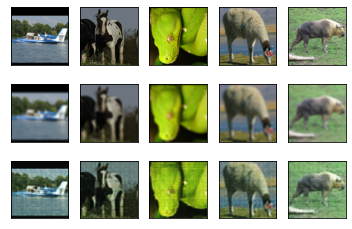

Epoch : [107/300] 

Training Loss: 0.003954	 validation Loss 0.004825
PNSR :21.45 	 SSIM : 0.77
PNSR :18.99 	 SSIM : 0.82
PNSR :21.37 	 SSIM : 0.69
PNSR :21.06 	 SSIM : 0.81
PNSR :19.28 	 SSIM : 0.76


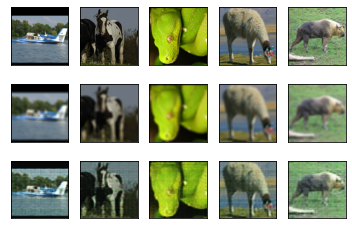

Epoch : [108/300] 

Training Loss: 0.003845	 validation Loss 0.004810
PNSR :21.61 	 SSIM : 0.78
PNSR :19.40 	 SSIM : 0.82
PNSR :21.46 	 SSIM : 0.69
PNSR :21.32 	 SSIM : 0.82
PNSR :19.52 	 SSIM : 0.76


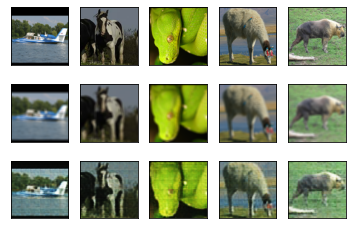

Epoch : [109/300] 

Training Loss: 0.003743	 validation Loss 0.004971
PNSR :21.27 	 SSIM : 0.78
PNSR :18.84 	 SSIM : 0.81
PNSR :20.91 	 SSIM : 0.68
PNSR :20.69 	 SSIM : 0.81
PNSR :19.83 	 SSIM : 0.76


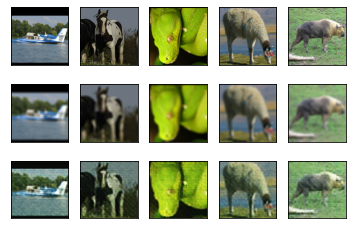

Epoch : [110/300] 

Training Loss: 0.003678	 validation Loss 0.004873
PNSR :20.99 	 SSIM : 0.77
PNSR :19.06 	 SSIM : 0.82
PNSR :21.06 	 SSIM : 0.68
PNSR :20.32 	 SSIM : 0.81
PNSR :19.05 	 SSIM : 0.76


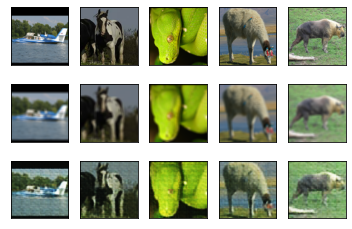

Epoch : [111/300] 

Training Loss: 0.003641	 validation Loss 0.004816
PNSR :21.26 	 SSIM : 0.77
PNSR :19.31 	 SSIM : 0.81
PNSR :21.73 	 SSIM : 0.67
PNSR :20.30 	 SSIM : 0.80
PNSR :19.17 	 SSIM : 0.75


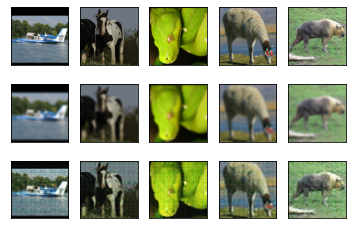

Epoch : [112/300] 

Training Loss: 0.003547	 validation Loss 0.005307
PNSR :20.88 	 SSIM : 0.77
PNSR :18.73 	 SSIM : 0.81
PNSR :21.61 	 SSIM : 0.68
PNSR :20.18 	 SSIM : 0.81
PNSR :19.17 	 SSIM : 0.75


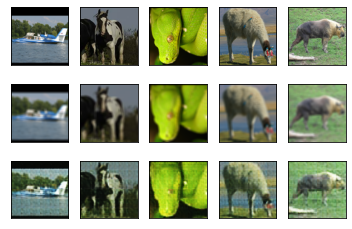

Epoch : [113/300] 

Training Loss: 0.003498	 validation Loss 0.005697
PNSR :20.59 	 SSIM : 0.76
PNSR :18.89 	 SSIM : 0.80
PNSR :20.15 	 SSIM : 0.67
PNSR :20.14 	 SSIM : 0.79
PNSR :18.90 	 SSIM : 0.73


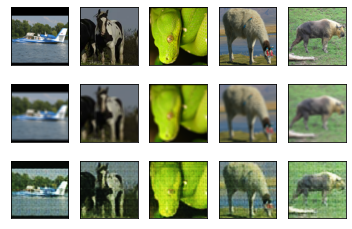

Epoch : [114/300] 

Training Loss: 0.003462	 validation Loss 0.004999
PNSR :21.04 	 SSIM : 0.77
PNSR :19.31 	 SSIM : 0.82
PNSR :21.38 	 SSIM : 0.68
PNSR :20.45 	 SSIM : 0.81
PNSR :18.64 	 SSIM : 0.75


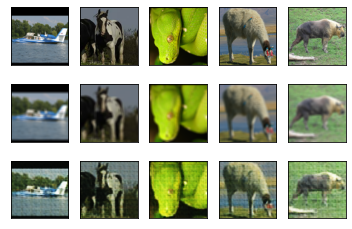

Epoch : [115/300] 

Training Loss: 0.003413	 validation Loss 0.005092
PNSR :20.89 	 SSIM : 0.78
PNSR :19.20 	 SSIM : 0.82
PNSR :20.55 	 SSIM : 0.68
PNSR :20.02 	 SSIM : 0.81
PNSR :19.36 	 SSIM : 0.75


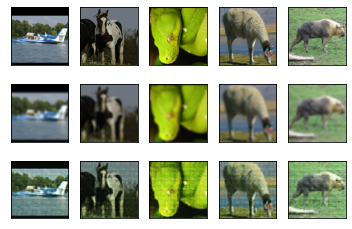

Epoch : [116/300] 

Training Loss: 0.003381	 validation Loss 0.004980
PNSR :21.50 	 SSIM : 0.79
PNSR :19.72 	 SSIM : 0.83
PNSR :21.84 	 SSIM : 0.69
PNSR :20.92 	 SSIM : 0.82
PNSR :20.19 	 SSIM : 0.76


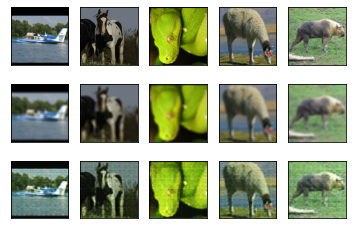

Epoch : [117/300] 

Training Loss: 0.003351	 validation Loss 0.004817
PNSR :22.00 	 SSIM : 0.79
PNSR :20.10 	 SSIM : 0.83
PNSR :21.99 	 SSIM : 0.69
PNSR :21.33 	 SSIM : 0.81
PNSR :19.85 	 SSIM : 0.76


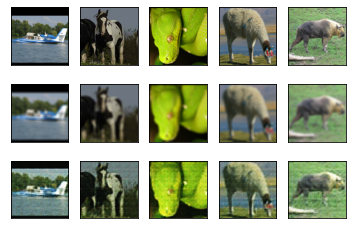

Epoch : [118/300] 

Training Loss: 0.003337	 validation Loss 0.004819
PNSR :20.60 	 SSIM : 0.78
PNSR :19.56 	 SSIM : 0.82
PNSR :21.61 	 SSIM : 0.70
PNSR :20.05 	 SSIM : 0.81
PNSR :19.63 	 SSIM : 0.76


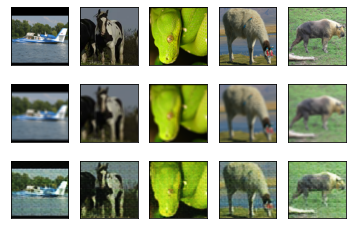

Epoch : [119/300] 

Training Loss: 0.003333	 validation Loss 0.007541
PNSR :19.66 	 SSIM : 0.65
PNSR :18.77 	 SSIM : 0.71
PNSR :19.91 	 SSIM : 0.62
PNSR :18.99 	 SSIM : 0.65
PNSR :18.02 	 SSIM : 0.62


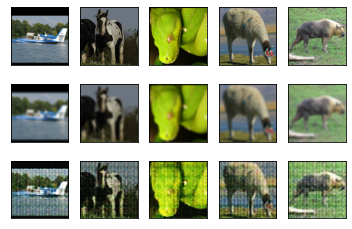

Epoch : [120/300] 

Training Loss: 0.003378	 validation Loss 0.004500
PNSR :22.81 	 SSIM : 0.77
PNSR :20.25 	 SSIM : 0.82
PNSR :22.73 	 SSIM : 0.68
PNSR :22.42 	 SSIM : 0.81
PNSR :20.79 	 SSIM : 0.76


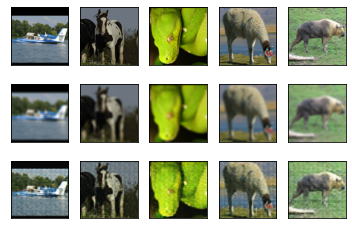

Epoch : [121/300] 

Training Loss: 0.003272	 validation Loss 0.004728
PNSR :21.36 	 SSIM : 0.78
PNSR :19.76 	 SSIM : 0.83
PNSR :20.66 	 SSIM : 0.70
PNSR :20.74 	 SSIM : 0.82
PNSR :19.78 	 SSIM : 0.77


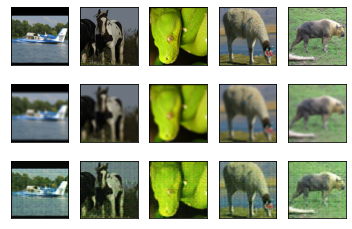

Epoch : [122/300] 

Training Loss: 0.003225	 validation Loss 0.004309
PNSR :21.92 	 SSIM : 0.79
PNSR :20.22 	 SSIM : 0.84
PNSR :21.99 	 SSIM : 0.69
PNSR :21.19 	 SSIM : 0.83
PNSR :19.79 	 SSIM : 0.77


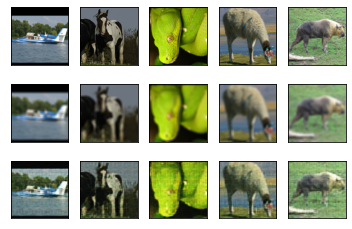

Epoch : [123/300] 

Training Loss: 0.003209	 validation Loss 0.004324
PNSR :22.56 	 SSIM : 0.80
PNSR :20.09 	 SSIM : 0.84
PNSR :22.73 	 SSIM : 0.70
PNSR :21.89 	 SSIM : 0.82
PNSR :20.18 	 SSIM : 0.77


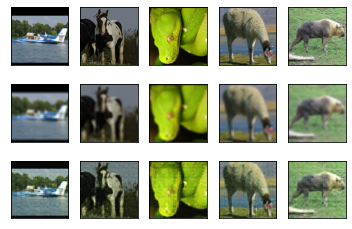

Epoch : [124/300] 

Training Loss: 0.003183	 validation Loss 0.004411
PNSR :21.29 	 SSIM : 0.80
PNSR :20.24 	 SSIM : 0.85
PNSR :21.38 	 SSIM : 0.71
PNSR :20.32 	 SSIM : 0.83
PNSR :19.17 	 SSIM : 0.78


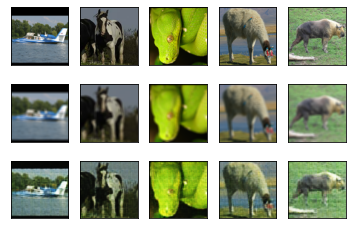

Epoch : [125/300] 

Training Loss: 0.003200	 validation Loss 0.004868
PNSR :21.30 	 SSIM : 0.76
PNSR :19.57 	 SSIM : 0.82
PNSR :21.29 	 SSIM : 0.68
PNSR :20.11 	 SSIM : 0.81
PNSR :18.74 	 SSIM : 0.76


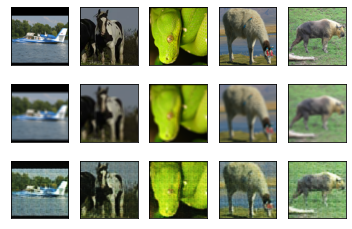

Epoch : [126/300] 

Training Loss: 0.003168	 validation Loss 0.005369
PNSR :20.50 	 SSIM : 0.75
PNSR :19.50 	 SSIM : 0.81
PNSR :20.83 	 SSIM : 0.68
PNSR :19.33 	 SSIM : 0.79
PNSR :17.93 	 SSIM : 0.73


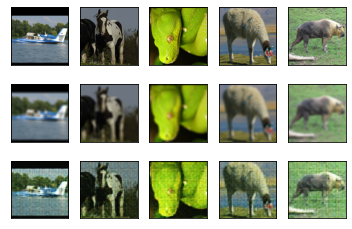

Epoch : [127/300] 

Training Loss: 0.003147	 validation Loss 0.004528
PNSR :22.15 	 SSIM : 0.78
PNSR :20.05 	 SSIM : 0.83
PNSR :22.93 	 SSIM : 0.69
PNSR :21.14 	 SSIM : 0.82
PNSR :19.84 	 SSIM : 0.76


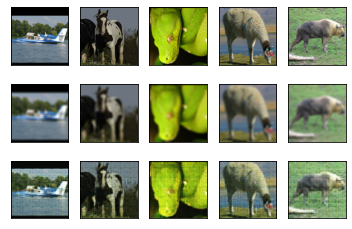

Epoch : [128/300] 

Training Loss: 0.003156	 validation Loss 0.004516
PNSR :21.88 	 SSIM : 0.78
PNSR :20.13 	 SSIM : 0.83
PNSR :22.96 	 SSIM : 0.70
PNSR :20.91 	 SSIM : 0.81
PNSR :19.35 	 SSIM : 0.75


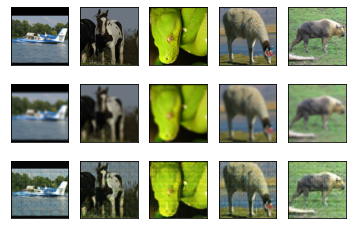

Epoch : [129/300] 

Training Loss: 0.003100	 validation Loss 0.004457
PNSR :22.43 	 SSIM : 0.77
PNSR :20.65 	 SSIM : 0.82
PNSR :23.52 	 SSIM : 0.68
PNSR :21.28 	 SSIM : 0.81
PNSR :19.67 	 SSIM : 0.75


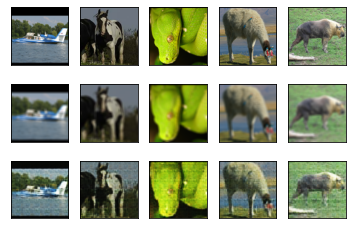

Epoch : [130/300] 

Training Loss: 0.003086	 validation Loss 0.004469
PNSR :21.29 	 SSIM : 0.79
PNSR :20.03 	 SSIM : 0.83
PNSR :22.17 	 SSIM : 0.70
PNSR :20.75 	 SSIM : 0.82
PNSR :19.55 	 SSIM : 0.76


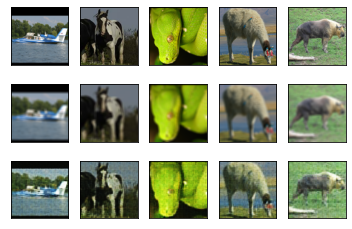

Epoch : [131/300] 

Training Loss: 0.003075	 validation Loss 0.004438
PNSR :22.47 	 SSIM : 0.78
PNSR :20.35 	 SSIM : 0.83
PNSR :23.51 	 SSIM : 0.70
PNSR :21.13 	 SSIM : 0.81
PNSR :19.85 	 SSIM : 0.76


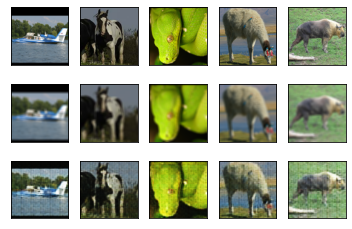

Epoch : [132/300] 

Training Loss: 0.003064	 validation Loss 0.004552
PNSR :22.78 	 SSIM : 0.78
PNSR :20.69 	 SSIM : 0.81
PNSR :23.47 	 SSIM : 0.68
PNSR :21.54 	 SSIM : 0.81
PNSR :20.20 	 SSIM : 0.76


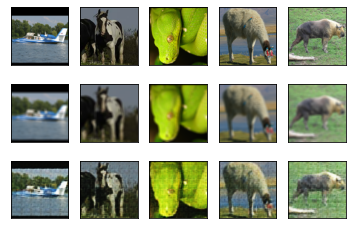

Epoch : [133/300] 

Training Loss: 0.003037	 validation Loss 0.004046
PNSR :22.56 	 SSIM : 0.79
PNSR :20.55 	 SSIM : 0.83
PNSR :22.69 	 SSIM : 0.69
PNSR :21.85 	 SSIM : 0.82
PNSR :20.19 	 SSIM : 0.77


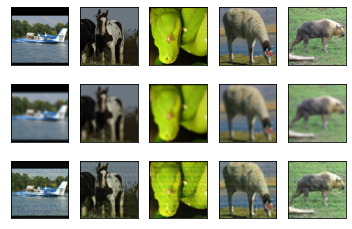

Epoch : [134/300] 

Training Loss: 0.003019	 validation Loss 0.005139
PNSR :21.01 	 SSIM : 0.75
PNSR :19.97 	 SSIM : 0.80
PNSR :22.62 	 SSIM : 0.67
PNSR :19.43 	 SSIM : 0.78
PNSR :18.53 	 SSIM : 0.73


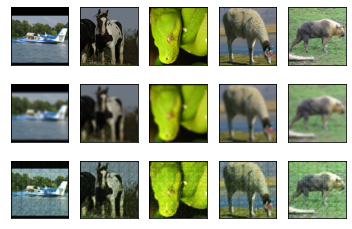

Epoch : [135/300] 

Training Loss: 0.003019	 validation Loss 0.004343
PNSR :23.23 	 SSIM : 0.78
PNSR :20.16 	 SSIM : 0.82
PNSR :23.82 	 SSIM : 0.68
PNSR :22.14 	 SSIM : 0.81
PNSR :20.40 	 SSIM : 0.75


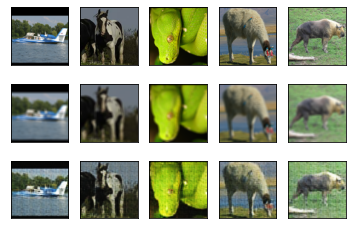

Epoch : [136/300] 

Training Loss: 0.002991	 validation Loss 0.003779
PNSR :21.91 	 SSIM : 0.80
PNSR :20.59 	 SSIM : 0.84
PNSR :23.91 	 SSIM : 0.71
PNSR :21.26 	 SSIM : 0.83
PNSR :19.27 	 SSIM : 0.78


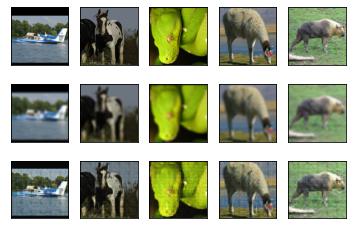

Epoch : [137/300] 

Training Loss: 0.002976	 validation Loss 0.004326
PNSR :22.65 	 SSIM : 0.78
PNSR :20.75 	 SSIM : 0.83
PNSR :24.05 	 SSIM : 0.69
PNSR :21.77 	 SSIM : 0.81
PNSR :20.69 	 SSIM : 0.75


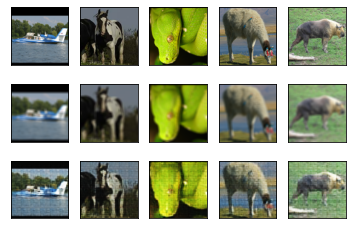

Epoch : [138/300] 

Training Loss: 0.003005	 validation Loss 0.004508
PNSR :21.39 	 SSIM : 0.77
PNSR :19.54 	 SSIM : 0.81
PNSR :22.50 	 SSIM : 0.67
PNSR :21.10 	 SSIM : 0.79
PNSR :19.41 	 SSIM : 0.74


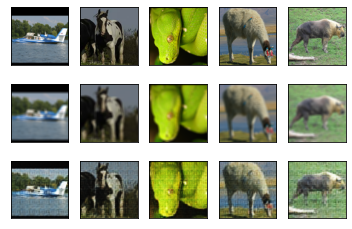

Epoch : [139/300] 

Training Loss: 0.002962	 validation Loss 0.004499
PNSR :20.98 	 SSIM : 0.76
PNSR :20.31 	 SSIM : 0.82
PNSR :22.27 	 SSIM : 0.67
PNSR :19.46 	 SSIM : 0.78
PNSR :18.22 	 SSIM : 0.73


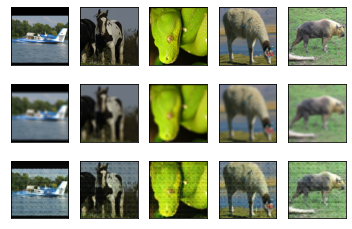

Epoch : [140/300] 

Training Loss: 0.002957	 validation Loss 0.004467
PNSR :22.12 	 SSIM : 0.77
PNSR :20.53 	 SSIM : 0.82
PNSR :23.43 	 SSIM : 0.68
PNSR :20.73 	 SSIM : 0.80
PNSR :19.56 	 SSIM : 0.75


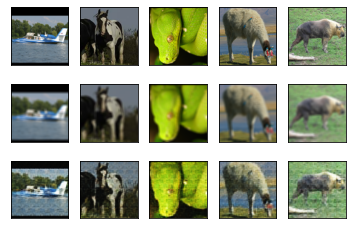

Epoch : [141/300] 

Training Loss: 0.002936	 validation Loss 0.004998
PNSR :20.73 	 SSIM : 0.75
PNSR :19.89 	 SSIM : 0.80
PNSR :21.54 	 SSIM : 0.67
PNSR :18.80 	 SSIM : 0.76
PNSR :17.84 	 SSIM : 0.72


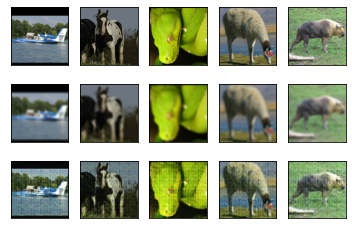

Epoch : [142/300] 

Training Loss: 0.002960	 validation Loss 0.004267
PNSR :22.18 	 SSIM : 0.79
PNSR :20.39 	 SSIM : 0.83
PNSR :22.84 	 SSIM : 0.69
PNSR :21.68 	 SSIM : 0.82
PNSR :20.72 	 SSIM : 0.76


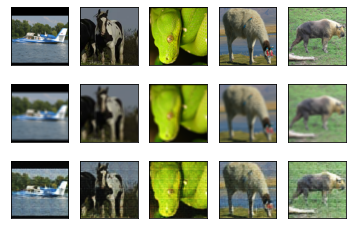

Epoch : [143/300] 

Training Loss: 0.002918	 validation Loss 0.003952
PNSR :21.95 	 SSIM : 0.81
PNSR :20.38 	 SSIM : 0.85
PNSR :22.71 	 SSIM : 0.72
PNSR :21.53 	 SSIM : 0.84
PNSR :19.94 	 SSIM : 0.78


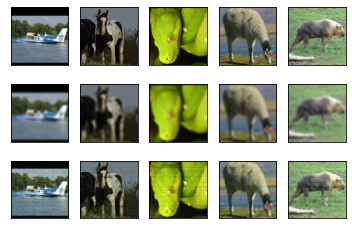

Epoch : [144/300] 

Training Loss: 0.002901	 validation Loss 0.004436
PNSR :21.77 	 SSIM : 0.79
PNSR :19.71 	 SSIM : 0.83
PNSR :22.44 	 SSIM : 0.68
PNSR :20.47 	 SSIM : 0.81
PNSR :19.45 	 SSIM : 0.76


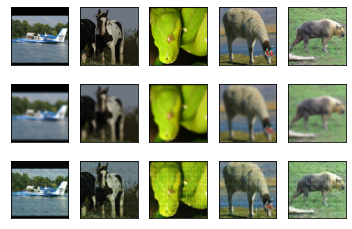

Epoch : [145/300] 

Training Loss: 0.002909	 validation Loss 0.004793
PNSR :21.64 	 SSIM : 0.75
PNSR :20.22 	 SSIM : 0.81
PNSR :22.75 	 SSIM : 0.68
PNSR :19.88 	 SSIM : 0.77
PNSR :19.27 	 SSIM : 0.72


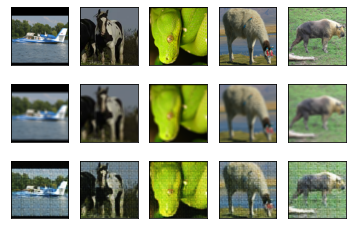

Epoch : [146/300] 

Training Loss: 0.002893	 validation Loss 0.004038
PNSR :21.51 	 SSIM : 0.79
PNSR :20.26 	 SSIM : 0.83
PNSR :22.68 	 SSIM : 0.70
PNSR :20.37 	 SSIM : 0.81
PNSR :19.31 	 SSIM : 0.76


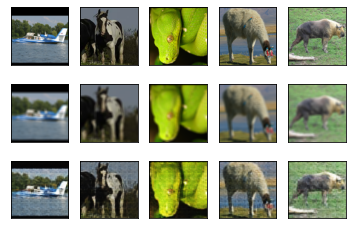

Epoch : [147/300] 

Training Loss: 0.002879	 validation Loss 0.004120
PNSR :22.24 	 SSIM : 0.79
PNSR :19.97 	 SSIM : 0.83
PNSR :23.04 	 SSIM : 0.70
PNSR :20.92 	 SSIM : 0.82
PNSR :19.85 	 SSIM : 0.76


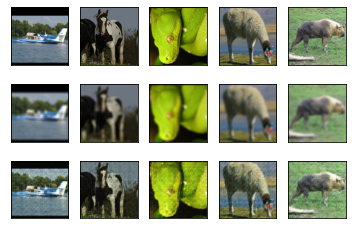

Epoch : [148/300] 

Training Loss: 0.002872	 validation Loss 0.004586
PNSR :20.84 	 SSIM : 0.76
PNSR :19.32 	 SSIM : 0.81
PNSR :21.74 	 SSIM : 0.68
PNSR :19.42 	 SSIM : 0.78
PNSR :18.10 	 SSIM : 0.73


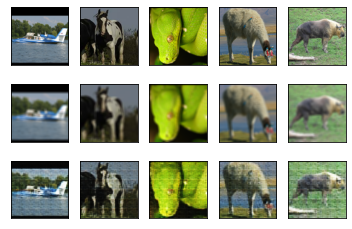

Epoch : [149/300] 

Training Loss: 0.002902	 validation Loss 0.004227
PNSR :21.39 	 SSIM : 0.78
PNSR :19.97 	 SSIM : 0.83
PNSR :22.49 	 SSIM : 0.70
PNSR :20.22 	 SSIM : 0.80
PNSR :19.32 	 SSIM : 0.76


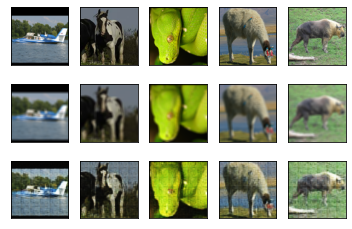

Epoch : [150/300] 

Training Loss: 0.002860	 validation Loss 0.004217
PNSR :21.89 	 SSIM : 0.78
PNSR :20.42 	 SSIM : 0.83
PNSR :23.67 	 SSIM : 0.70
PNSR :20.96 	 SSIM : 0.80
PNSR :19.43 	 SSIM : 0.75


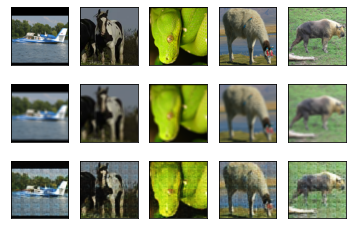

Epoch : [151/300] 

Training Loss: 0.002845	 validation Loss 0.004074
PNSR :22.21 	 SSIM : 0.78
PNSR :19.84 	 SSIM : 0.82
PNSR :22.38 	 SSIM : 0.69
PNSR :21.35 	 SSIM : 0.81
PNSR :19.81 	 SSIM : 0.76


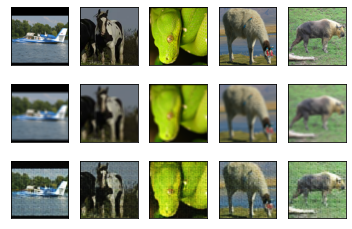

Epoch : [152/300] 

Training Loss: 0.002851	 validation Loss 0.004444
PNSR :20.54 	 SSIM : 0.77
PNSR :19.35 	 SSIM : 0.81
PNSR :21.07 	 SSIM : 0.67
PNSR :19.76 	 SSIM : 0.79
PNSR :19.08 	 SSIM : 0.74


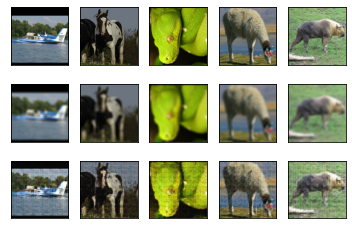

Epoch : [153/300] 

Training Loss: 0.002851	 validation Loss 0.004084
PNSR :22.33 	 SSIM : 0.79
PNSR :20.20 	 SSIM : 0.83
PNSR :23.44 	 SSIM : 0.70
PNSR :21.43 	 SSIM : 0.81
PNSR :20.19 	 SSIM : 0.76


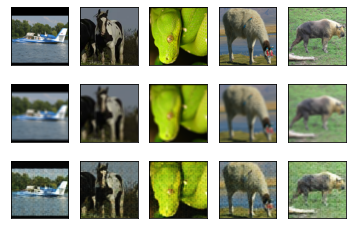

Epoch : [154/300] 

Training Loss: 0.002836	 validation Loss 0.004324
PNSR :21.23 	 SSIM : 0.78
PNSR :20.18 	 SSIM : 0.82
PNSR :22.45 	 SSIM : 0.68
PNSR :19.79 	 SSIM : 0.79
PNSR :18.16 	 SSIM : 0.74


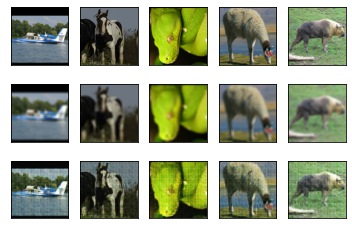

Epoch : [155/300] 

Training Loss: 0.002856	 validation Loss 0.003965
PNSR :22.67 	 SSIM : 0.77
PNSR :20.39 	 SSIM : 0.82
PNSR :23.91 	 SSIM : 0.70
PNSR :21.84 	 SSIM : 0.80
PNSR :20.49 	 SSIM : 0.75


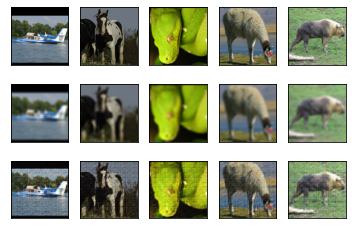

Epoch : [156/300] 

Training Loss: 0.002837	 validation Loss 0.003882
PNSR :21.26 	 SSIM : 0.80
PNSR :20.23 	 SSIM : 0.85
PNSR :22.53 	 SSIM : 0.72
PNSR :20.28 	 SSIM : 0.82
PNSR :19.63 	 SSIM : 0.77


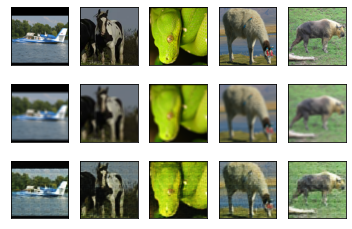

Epoch : [157/300] 

Training Loss: 0.002815	 validation Loss 0.004606
PNSR :20.51 	 SSIM : 0.75
PNSR :19.56 	 SSIM : 0.81
PNSR :21.32 	 SSIM : 0.66
PNSR :19.67 	 SSIM : 0.77
PNSR :18.20 	 SSIM : 0.71


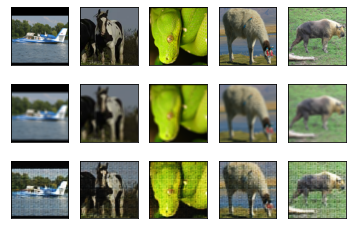

Epoch : [158/300] 

Training Loss: 0.002828	 validation Loss 0.003873
PNSR :23.30 	 SSIM : 0.79
PNSR :20.27 	 SSIM : 0.84
PNSR :24.05 	 SSIM : 0.71
PNSR :21.84 	 SSIM : 0.82
PNSR :20.77 	 SSIM : 0.76


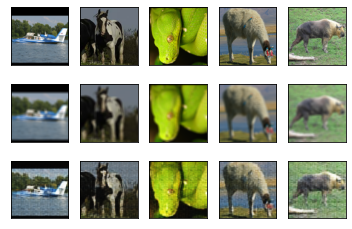

Epoch : [159/300] 

Training Loss: 0.002821	 validation Loss 0.004842
PNSR :20.71 	 SSIM : 0.73
PNSR :19.78 	 SSIM : 0.80
PNSR :21.89 	 SSIM : 0.67
PNSR :19.00 	 SSIM : 0.75
PNSR :18.64 	 SSIM : 0.70


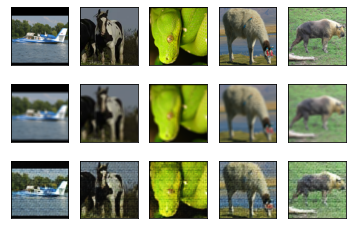

Epoch : [160/300] 

Training Loss: 0.002830	 validation Loss 0.004252
PNSR :21.29 	 SSIM : 0.78
PNSR :19.25 	 SSIM : 0.82
PNSR :22.34 	 SSIM : 0.68
PNSR :19.54 	 SSIM : 0.80
PNSR :18.68 	 SSIM : 0.75


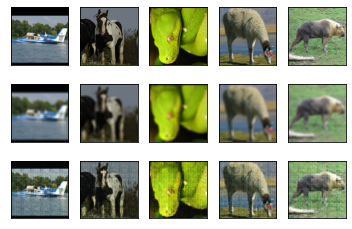

Epoch : [161/300] 

Training Loss: 0.002798	 validation Loss 0.004112
PNSR :21.74 	 SSIM : 0.80
PNSR :20.11 	 SSIM : 0.84
PNSR :23.01 	 SSIM : 0.70
PNSR :20.28 	 SSIM : 0.82
PNSR :19.64 	 SSIM : 0.76


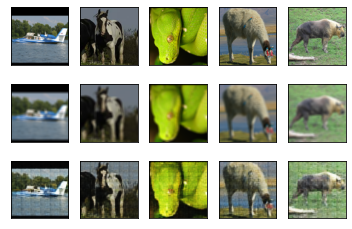

Epoch : [162/300] 

Training Loss: 0.002817	 validation Loss 0.004646
PNSR :20.40 	 SSIM : 0.76
PNSR :19.08 	 SSIM : 0.81
PNSR :22.19 	 SSIM : 0.67
PNSR :19.07 	 SSIM : 0.77
PNSR :18.22 	 SSIM : 0.73


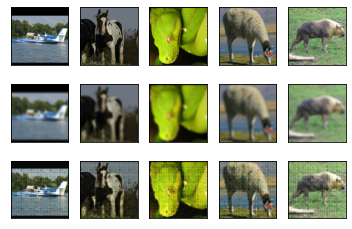

Epoch : [163/300] 

Training Loss: 0.002832	 validation Loss 0.003987
PNSR :22.32 	 SSIM : 0.80
PNSR :20.38 	 SSIM : 0.84
PNSR :23.22 	 SSIM : 0.70
PNSR :20.66 	 SSIM : 0.82
PNSR :19.74 	 SSIM : 0.76


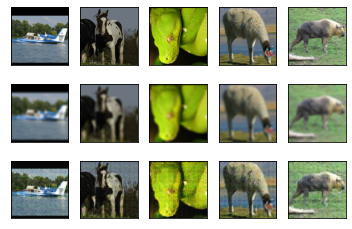

Epoch : [164/300] 

Training Loss: 0.002798	 validation Loss 0.003744
PNSR :22.74 	 SSIM : 0.81
PNSR :20.62 	 SSIM : 0.85
PNSR :23.46 	 SSIM : 0.71
PNSR :21.76 	 SSIM : 0.83
PNSR :20.30 	 SSIM : 0.78


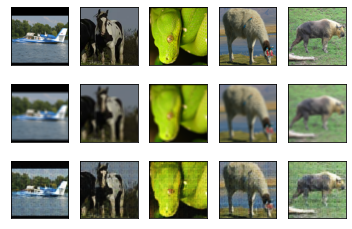

Epoch : [165/300] 

Training Loss: 0.002784	 validation Loss 0.004394
PNSR :21.00 	 SSIM : 0.78
PNSR :20.22 	 SSIM : 0.82
PNSR :22.55 	 SSIM : 0.69
PNSR :19.34 	 SSIM : 0.79
PNSR :18.89 	 SSIM : 0.74


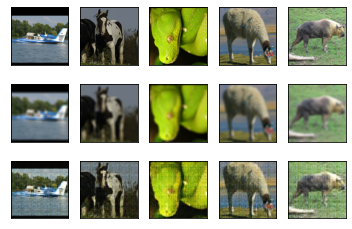

Epoch : [166/300] 

Training Loss: 0.002818	 validation Loss 0.005030
PNSR :20.28 	 SSIM : 0.74
PNSR :19.93 	 SSIM : 0.79
PNSR :20.89 	 SSIM : 0.65
PNSR :18.66 	 SSIM : 0.74
PNSR :18.08 	 SSIM : 0.70


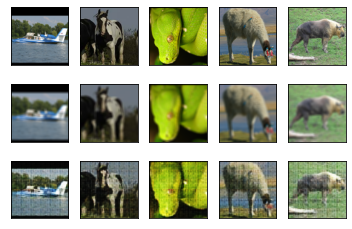

Epoch : [167/300] 

Training Loss: 0.002783	 validation Loss 0.004538
PNSR :21.21 	 SSIM : 0.76
PNSR :19.96 	 SSIM : 0.81
PNSR :22.46 	 SSIM : 0.67
PNSR :20.18 	 SSIM : 0.78
PNSR :19.45 	 SSIM : 0.73


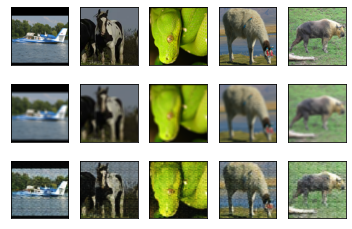

Epoch : [168/300] 

Training Loss: 0.002785	 validation Loss 0.005234
PNSR :20.00 	 SSIM : 0.73
PNSR :19.12 	 SSIM : 0.78
PNSR :21.39 	 SSIM : 0.65
PNSR :18.77 	 SSIM : 0.73
PNSR :18.05 	 SSIM : 0.69


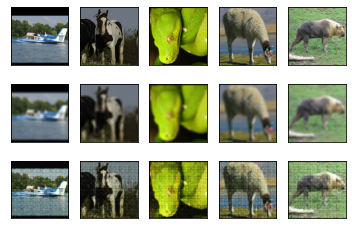

Epoch : [169/300] 

Training Loss: 0.002780	 validation Loss 0.004408
PNSR :19.54 	 SSIM : 0.76
PNSR :19.21 	 SSIM : 0.82
PNSR :21.33 	 SSIM : 0.68
PNSR :18.55 	 SSIM : 0.78
PNSR :18.03 	 SSIM : 0.74


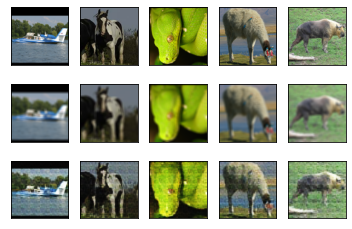

Epoch : [170/300] 

Training Loss: 0.002788	 validation Loss 0.004548
PNSR :22.06 	 SSIM : 0.77
PNSR :20.58 	 SSIM : 0.82
PNSR :24.09 	 SSIM : 0.68
PNSR :20.83 	 SSIM : 0.79
PNSR :20.17 	 SSIM : 0.75


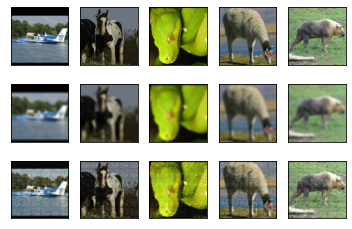

Epoch : [171/300] 

Training Loss: 0.002764	 validation Loss 0.004135
PNSR :21.48 	 SSIM : 0.79
PNSR :20.14 	 SSIM : 0.83
PNSR :22.61 	 SSIM : 0.70
PNSR :20.04 	 SSIM : 0.81
PNSR :19.46 	 SSIM : 0.76


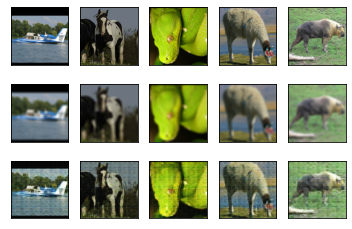

Epoch : [172/300] 

Training Loss: 0.002793	 validation Loss 0.004786
PNSR :20.88 	 SSIM : 0.75
PNSR :19.80 	 SSIM : 0.80
PNSR :23.25 	 SSIM : 0.68
PNSR :20.09 	 SSIM : 0.77
PNSR :19.29 	 SSIM : 0.73


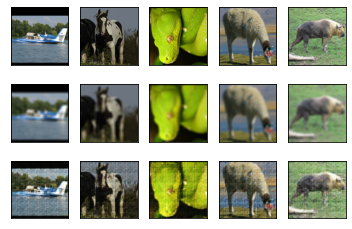

Epoch : [173/300] 

Training Loss: 0.002761	 validation Loss 0.004464
PNSR :21.43 	 SSIM : 0.78
PNSR :19.91 	 SSIM : 0.81
PNSR :22.35 	 SSIM : 0.69
PNSR :19.89 	 SSIM : 0.79
PNSR :19.36 	 SSIM : 0.75


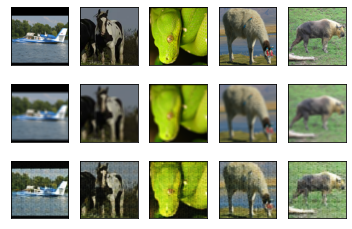

Epoch : [174/300] 

Training Loss: 0.002777	 validation Loss 0.004539
PNSR :21.79 	 SSIM : 0.76
PNSR :19.73 	 SSIM : 0.80
PNSR :22.34 	 SSIM : 0.66
PNSR :20.04 	 SSIM : 0.77
PNSR :19.20 	 SSIM : 0.74


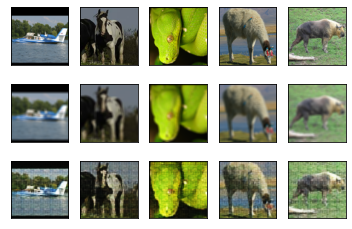

Epoch : [175/300] 

Training Loss: 0.002801	 validation Loss 0.005162
PNSR :20.74 	 SSIM : 0.74
PNSR :20.57 	 SSIM : 0.80
PNSR :22.23 	 SSIM : 0.67
PNSR :18.95 	 SSIM : 0.75
PNSR :18.54 	 SSIM : 0.70


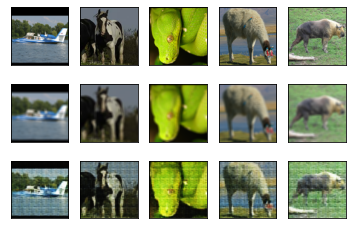

Epoch : [176/300] 

Training Loss: 0.002773	 validation Loss 0.003965
PNSR :21.13 	 SSIM : 0.80
PNSR :19.90 	 SSIM : 0.85
PNSR :22.06 	 SSIM : 0.72
PNSR :19.90 	 SSIM : 0.82
PNSR :19.25 	 SSIM : 0.78


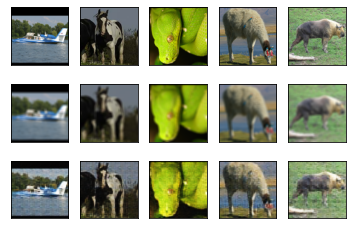

Epoch : [177/300] 

Training Loss: 0.002743	 validation Loss 0.005082
PNSR :19.39 	 SSIM : 0.74
PNSR :18.62 	 SSIM : 0.79
PNSR :20.93 	 SSIM : 0.66
PNSR :18.07 	 SSIM : 0.75
PNSR :17.79 	 SSIM : 0.70


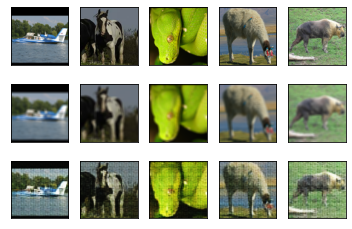

Epoch : [178/300] 

Training Loss: 0.002762	 validation Loss 0.004313
PNSR :22.03 	 SSIM : 0.78
PNSR :20.67 	 SSIM : 0.82
PNSR :23.24 	 SSIM : 0.68
PNSR :21.35 	 SSIM : 0.79
PNSR :20.57 	 SSIM : 0.74


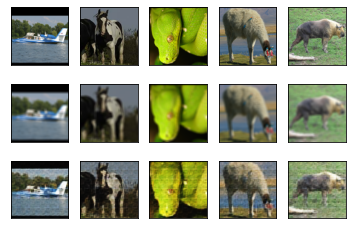

Epoch : [179/300] 

Training Loss: 0.002735	 validation Loss 0.004475
PNSR :20.71 	 SSIM : 0.77
PNSR :19.62 	 SSIM : 0.82
PNSR :22.43 	 SSIM : 0.68
PNSR :19.15 	 SSIM : 0.80
PNSR :18.92 	 SSIM : 0.75


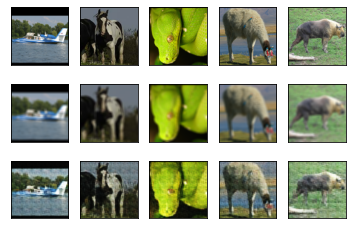

Epoch : [180/300] 

Training Loss: 0.002770	 validation Loss 0.005566
PNSR :21.24 	 SSIM : 0.70
PNSR :20.53 	 SSIM : 0.76
PNSR :23.30 	 SSIM : 0.63
PNSR :20.02 	 SSIM : 0.70
PNSR :19.38 	 SSIM : 0.66


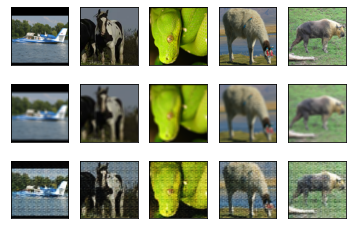

Epoch : [181/300] 

Training Loss: 0.002723	 validation Loss 0.004081
PNSR :20.98 	 SSIM : 0.79
PNSR :19.67 	 SSIM : 0.83
PNSR :22.74 	 SSIM : 0.70
PNSR :19.37 	 SSIM : 0.81
PNSR :19.13 	 SSIM : 0.77


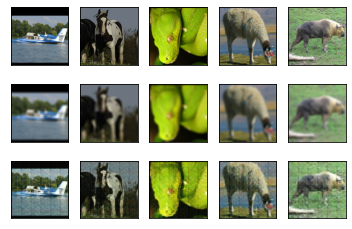

Epoch : [182/300] 

Training Loss: 0.002742	 validation Loss 0.004398
PNSR :21.80 	 SSIM : 0.77
PNSR :20.62 	 SSIM : 0.82
PNSR :24.03 	 SSIM : 0.68
PNSR :20.79 	 SSIM : 0.79
PNSR :19.85 	 SSIM : 0.75


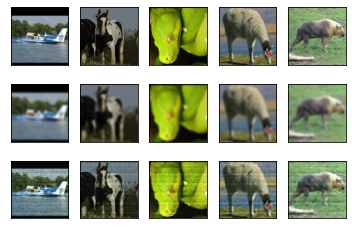

Epoch : [183/300] 

Training Loss: 0.002734	 validation Loss 0.004128
PNSR :21.91 	 SSIM : 0.78
PNSR :20.54 	 SSIM : 0.82
PNSR :24.17 	 SSIM : 0.70
PNSR :21.61 	 SSIM : 0.79
PNSR :20.01 	 SSIM : 0.75


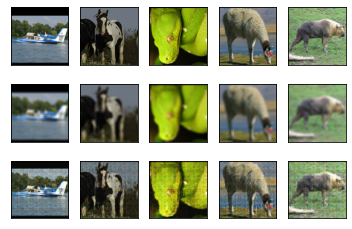

Epoch : [184/300] 

Training Loss: 0.002755	 validation Loss 0.004128
PNSR :21.80 	 SSIM : 0.80
PNSR :20.41 	 SSIM : 0.83
PNSR :23.19 	 SSIM : 0.71
PNSR :20.47 	 SSIM : 0.82
PNSR :19.87 	 SSIM : 0.77


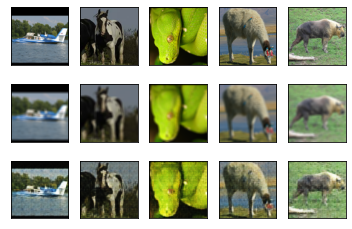

Epoch : [185/300] 

Training Loss: 0.002723	 validation Loss 0.004186
PNSR :22.33 	 SSIM : 0.78
PNSR :20.80 	 SSIM : 0.83
PNSR :23.80 	 SSIM : 0.70
PNSR :20.58 	 SSIM : 0.80
PNSR :20.27 	 SSIM : 0.75


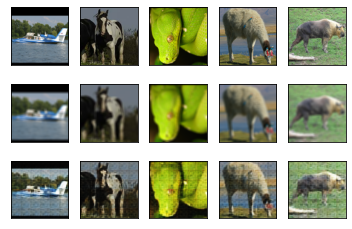

Epoch : [186/300] 

Training Loss: 0.002745	 validation Loss 0.004976
PNSR :20.18 	 SSIM : 0.72
PNSR :19.71 	 SSIM : 0.78
PNSR :22.50 	 SSIM : 0.68
PNSR :19.66 	 SSIM : 0.74
PNSR :19.01 	 SSIM : 0.71


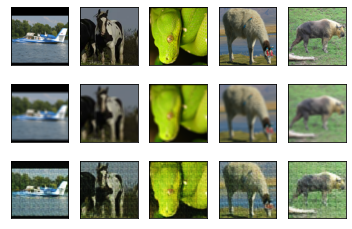

Epoch : [187/300] 

Training Loss: 0.002902	 validation Loss 0.005544
PNSR :18.87 	 SSIM : 0.70
PNSR :18.30 	 SSIM : 0.76
PNSR :20.70 	 SSIM : 0.64
PNSR :18.88 	 SSIM : 0.71
PNSR :17.22 	 SSIM : 0.66


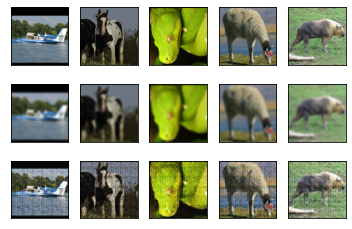

Epoch : [188/300] 

Training Loss: 0.002733	 validation Loss 0.004064
PNSR :23.34 	 SSIM : 0.80
PNSR :20.75 	 SSIM : 0.84
PNSR :23.52 	 SSIM : 0.70
PNSR :22.20 	 SSIM : 0.82
PNSR :21.29 	 SSIM : 0.77


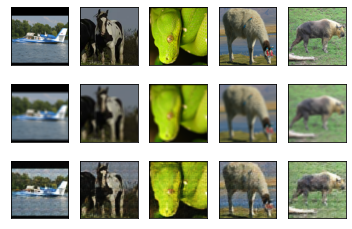

Epoch : [189/300] 

Training Loss: 0.002722	 validation Loss 0.004106
PNSR :22.48 	 SSIM : 0.77
PNSR :21.11 	 SSIM : 0.82
PNSR :24.23 	 SSIM : 0.69
PNSR :20.85 	 SSIM : 0.80
PNSR :19.94 	 SSIM : 0.75


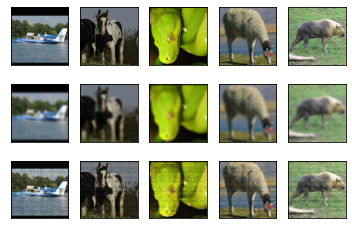

Epoch : [190/300] 

Training Loss: 0.002734	 validation Loss 0.003686
PNSR :22.79 	 SSIM : 0.80
PNSR :21.30 	 SSIM : 0.85
PNSR :24.46 	 SSIM : 0.71
PNSR :22.67 	 SSIM : 0.83
PNSR :20.77 	 SSIM : 0.78


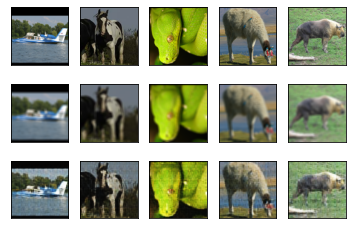

Epoch : [191/300] 

Training Loss: 0.002730	 validation Loss 0.003994
PNSR :21.93 	 SSIM : 0.79
PNSR :20.21 	 SSIM : 0.84
PNSR :23.35 	 SSIM : 0.70
PNSR :20.48 	 SSIM : 0.81
PNSR :19.63 	 SSIM : 0.76


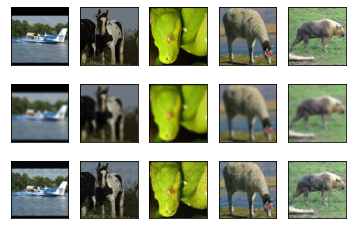

Epoch : [192/300] 

Training Loss: 0.002729	 validation Loss 0.003711
PNSR :22.11 	 SSIM : 0.80
PNSR :20.18 	 SSIM : 0.84
PNSR :23.16 	 SSIM : 0.71
PNSR :21.41 	 SSIM : 0.82
PNSR :20.53 	 SSIM : 0.78


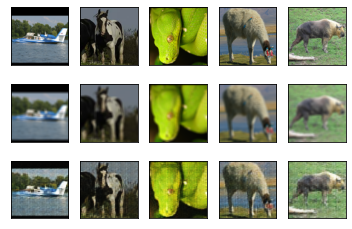

Epoch : [193/300] 

Training Loss: 0.002711	 validation Loss 0.003947
PNSR :21.32 	 SSIM : 0.79
PNSR :19.97 	 SSIM : 0.83
PNSR :22.73 	 SSIM : 0.70
PNSR :19.42 	 SSIM : 0.81
PNSR :19.41 	 SSIM : 0.77


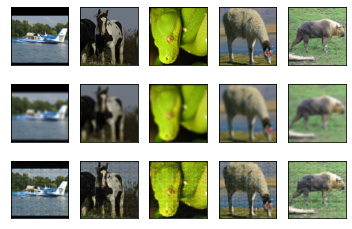

Epoch : [194/300] 

Training Loss: 0.002727	 validation Loss 0.004293
PNSR :21.95 	 SSIM : 0.78
PNSR :20.57 	 SSIM : 0.83
PNSR :23.76 	 SSIM : 0.69
PNSR :21.13 	 SSIM : 0.80
PNSR :19.85 	 SSIM : 0.75


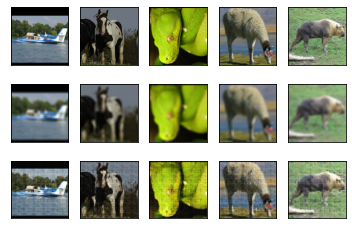

Epoch : [195/300] 

Training Loss: 0.002703	 validation Loss 0.003972
PNSR :21.41 	 SSIM : 0.79
PNSR :20.03 	 SSIM : 0.84
PNSR :22.61 	 SSIM : 0.72
PNSR :20.45 	 SSIM : 0.81
PNSR :19.60 	 SSIM : 0.76


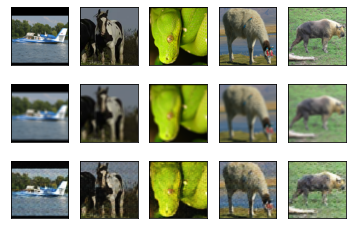

Epoch : [196/300] 

Training Loss: 0.002714	 validation Loss 0.003793
PNSR :22.58 	 SSIM : 0.80
PNSR :20.71 	 SSIM : 0.84
PNSR :24.88 	 SSIM : 0.72
PNSR :21.84 	 SSIM : 0.83
PNSR :20.49 	 SSIM : 0.78


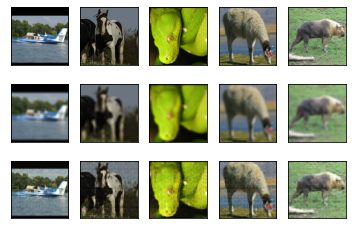

Epoch : [197/300] 

Training Loss: 0.002719	 validation Loss 0.004665
PNSR :21.29 	 SSIM : 0.75
PNSR :20.55 	 SSIM : 0.81
PNSR :23.46 	 SSIM : 0.67
PNSR :20.23 	 SSIM : 0.76
PNSR :19.53 	 SSIM : 0.72


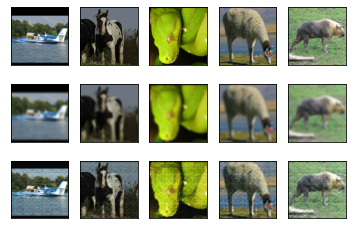

Epoch : [198/300] 

Training Loss: 0.002732	 validation Loss 0.004541
PNSR :21.37 	 SSIM : 0.76
PNSR :19.86 	 SSIM : 0.81
PNSR :22.82 	 SSIM : 0.66
PNSR :20.03 	 SSIM : 0.78
PNSR :18.77 	 SSIM : 0.73


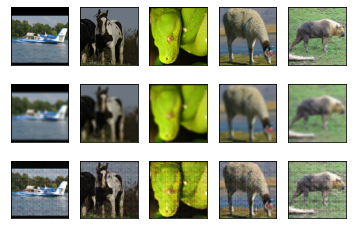

Epoch : [199/300] 

Training Loss: 0.002726	 validation Loss 0.004560
PNSR :20.88 	 SSIM : 0.75
PNSR :19.27 	 SSIM : 0.80
PNSR :21.75 	 SSIM : 0.67
PNSR :20.06 	 SSIM : 0.77
PNSR :19.33 	 SSIM : 0.73


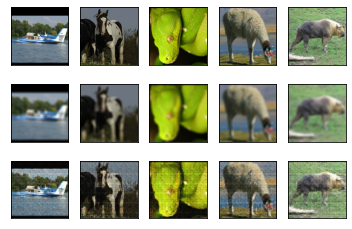

Epoch : [200/300] 

Training Loss: 0.002711	 validation Loss 0.004039
PNSR :21.41 	 SSIM : 0.79
PNSR :20.23 	 SSIM : 0.83
PNSR :22.56 	 SSIM : 0.71
PNSR :19.63 	 SSIM : 0.80
PNSR :19.34 	 SSIM : 0.76


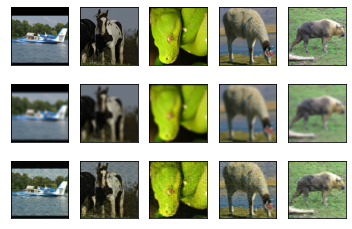

Epoch : [201/300] 

Training Loss: 0.002723	 validation Loss 0.005307
PNSR :21.34 	 SSIM : 0.69
PNSR :20.05 	 SSIM : 0.77
PNSR :23.56 	 SSIM : 0.65
PNSR :19.89 	 SSIM : 0.71
PNSR :19.04 	 SSIM : 0.66


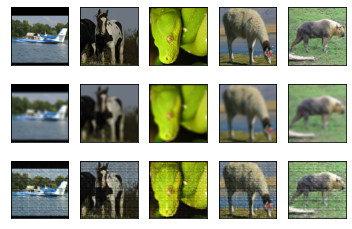

Epoch : [202/300] 

Training Loss: 0.002713	 validation Loss 0.004348
PNSR :21.90 	 SSIM : 0.78
PNSR :20.04 	 SSIM : 0.82
PNSR :22.00 	 SSIM : 0.69
PNSR :20.19 	 SSIM : 0.79
PNSR :20.26 	 SSIM : 0.75


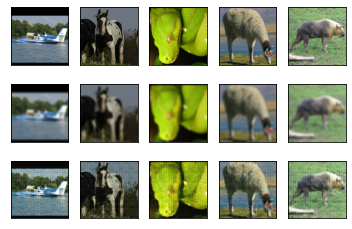

Epoch : [203/300] 

Training Loss: 0.002724	 validation Loss 0.004775
PNSR :19.83 	 SSIM : 0.73
PNSR :19.65 	 SSIM : 0.80
PNSR :22.24 	 SSIM : 0.66
PNSR :19.62 	 SSIM : 0.74
PNSR :18.70 	 SSIM : 0.70


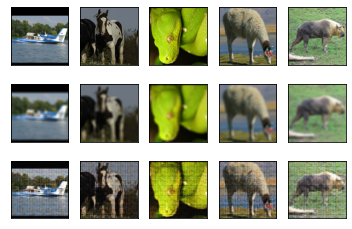

Epoch : [204/300] 

Training Loss: 0.002727	 validation Loss 0.004560
PNSR :21.10 	 SSIM : 0.77
PNSR :20.05 	 SSIM : 0.82
PNSR :23.08 	 SSIM : 0.68
PNSR :19.81 	 SSIM : 0.79
PNSR :19.28 	 SSIM : 0.74


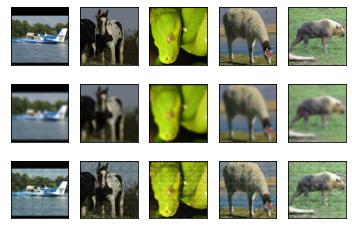

Epoch : [205/300] 

Training Loss: 0.002718	 validation Loss 0.005024
PNSR :20.23 	 SSIM : 0.73
PNSR :19.97 	 SSIM : 0.79
PNSR :22.46 	 SSIM : 0.67
PNSR :19.72 	 SSIM : 0.74
PNSR :18.98 	 SSIM : 0.70


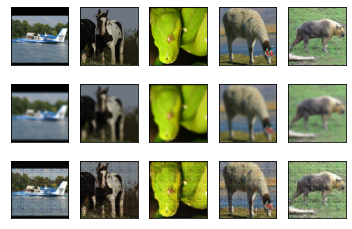

Epoch : [206/300] 

Training Loss: 0.002716	 validation Loss 0.004506
PNSR :20.76 	 SSIM : 0.77
PNSR :20.02 	 SSIM : 0.82
PNSR :22.10 	 SSIM : 0.69
PNSR :19.64 	 SSIM : 0.79
PNSR :18.57 	 SSIM : 0.73


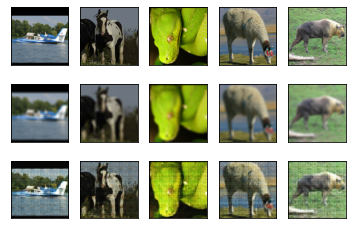

Epoch : [207/300] 

Training Loss: 0.002710	 validation Loss 0.004717
PNSR :20.20 	 SSIM : 0.75
PNSR :19.70 	 SSIM : 0.80
PNSR :21.03 	 SSIM : 0.68
PNSR :18.57 	 SSIM : 0.76
PNSR :17.90 	 SSIM : 0.71


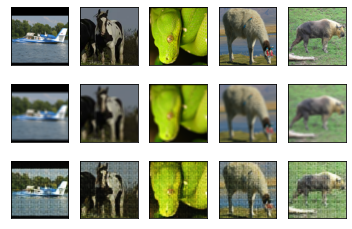

Epoch : [208/300] 

Training Loss: 0.002715	 validation Loss 0.004503
PNSR :21.85 	 SSIM : 0.77
PNSR :20.19 	 SSIM : 0.81
PNSR :22.05 	 SSIM : 0.68
PNSR :20.76 	 SSIM : 0.79
PNSR :19.54 	 SSIM : 0.74


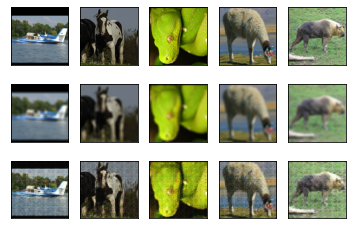

Epoch : [209/300] 

Training Loss: 0.002695	 validation Loss 0.004046
PNSR :20.85 	 SSIM : 0.78
PNSR :19.71 	 SSIM : 0.83
PNSR :22.96 	 SSIM : 0.70
PNSR :19.88 	 SSIM : 0.80
PNSR :18.86 	 SSIM : 0.75


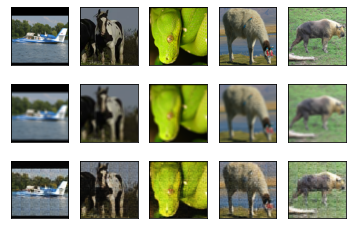

Epoch : [210/300] 

Training Loss: 0.002709	 validation Loss 0.004218
PNSR :22.01 	 SSIM : 0.77
PNSR :19.98 	 SSIM : 0.82
PNSR :23.11 	 SSIM : 0.69
PNSR :20.25 	 SSIM : 0.79
PNSR :19.00 	 SSIM : 0.74


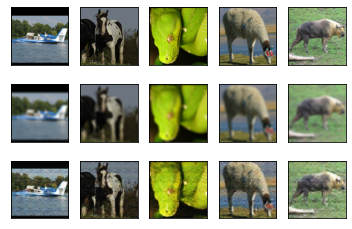

Epoch : [211/300] 

Training Loss: 0.005759	 validation Loss 0.024456
PNSR :11.16 	 SSIM : 0.50
PNSR :12.44 	 SSIM : 0.40
PNSR :13.66 	 SSIM : 0.42
PNSR :10.49 	 SSIM : 0.43
PNSR :12.36 	 SSIM : 0.42


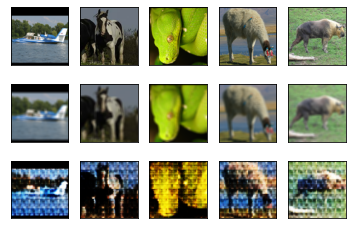

Epoch : [212/300] 

Training Loss: 0.004748	 validation Loss 0.006352
PNSR :19.22 	 SSIM : 0.70
PNSR :17.42 	 SSIM : 0.76
PNSR :20.83 	 SSIM : 0.63
PNSR :18.66 	 SSIM : 0.72
PNSR :17.16 	 SSIM : 0.67


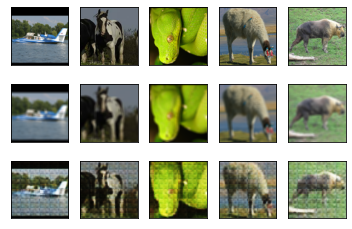

Epoch : [213/300] 

Training Loss: 0.003892	 validation Loss 0.005472
PNSR :19.16 	 SSIM : 0.72
PNSR :17.96 	 SSIM : 0.76
PNSR :20.82 	 SSIM : 0.66
PNSR :18.57 	 SSIM : 0.73
PNSR :17.68 	 SSIM : 0.67


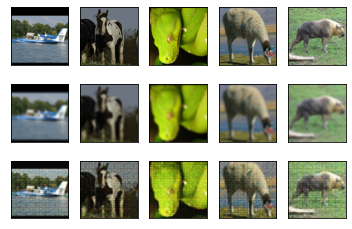

Epoch : [214/300] 

Training Loss: 0.003609	 validation Loss 0.004601
PNSR :21.39 	 SSIM : 0.75
PNSR :19.21 	 SSIM : 0.80
PNSR :22.29 	 SSIM : 0.68
PNSR :19.97 	 SSIM : 0.78
PNSR :18.98 	 SSIM : 0.72


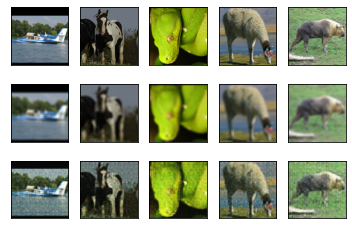

Epoch : [215/300] 

Training Loss: 0.003336	 validation Loss 0.004192
PNSR :21.66 	 SSIM : 0.78
PNSR :19.40 	 SSIM : 0.82
PNSR :23.03 	 SSIM : 0.69
PNSR :21.02 	 SSIM : 0.80
PNSR :19.93 	 SSIM : 0.74


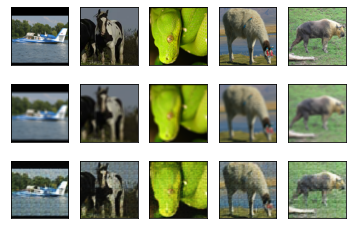

Epoch : [216/300] 

Training Loss: 0.003240	 validation Loss 0.004399
PNSR :21.36 	 SSIM : 0.75
PNSR :19.78 	 SSIM : 0.81
PNSR :22.69 	 SSIM : 0.69
PNSR :20.82 	 SSIM : 0.77
PNSR :19.70 	 SSIM : 0.73


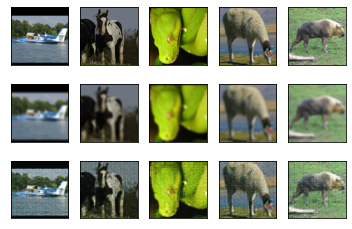

Epoch : [217/300] 

Training Loss: 0.003126	 validation Loss 0.003993
PNSR :22.21 	 SSIM : 0.79
PNSR :19.55 	 SSIM : 0.83
PNSR :23.60 	 SSIM : 0.70
PNSR :20.91 	 SSIM : 0.81
PNSR :20.05 	 SSIM : 0.75


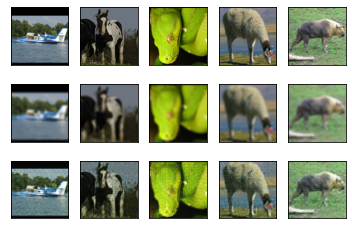

Epoch : [218/300] 

Training Loss: 0.003023	 validation Loss 0.004180
PNSR :21.58 	 SSIM : 0.76
PNSR :19.92 	 SSIM : 0.82
PNSR :22.77 	 SSIM : 0.68
PNSR :21.09 	 SSIM : 0.80
PNSR :19.53 	 SSIM : 0.73


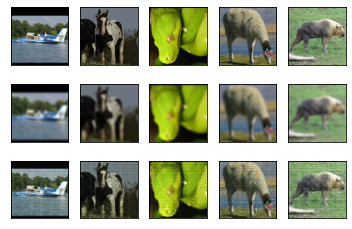

Epoch : [219/300] 

Training Loss: 0.002991	 validation Loss 0.003943
PNSR :21.86 	 SSIM : 0.78
PNSR :19.57 	 SSIM : 0.83
PNSR :23.45 	 SSIM : 0.69
PNSR :21.62 	 SSIM : 0.82
PNSR :19.85 	 SSIM : 0.76


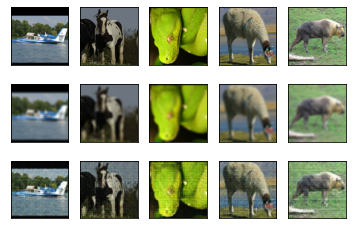

Epoch : [220/300] 

Training Loss: 0.002940	 validation Loss 0.004215
PNSR :21.58 	 SSIM : 0.76
PNSR :19.57 	 SSIM : 0.82
PNSR :23.33 	 SSIM : 0.68
PNSR :20.93 	 SSIM : 0.79
PNSR :19.65 	 SSIM : 0.74


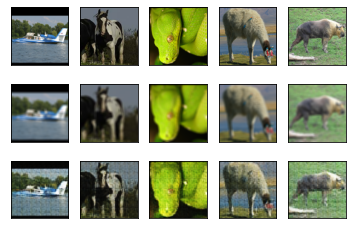

Epoch : [221/300] 

Training Loss: 0.002896	 validation Loss 0.004284
PNSR :20.33 	 SSIM : 0.77
PNSR :18.90 	 SSIM : 0.82
PNSR :21.31 	 SSIM : 0.69
PNSR :19.46 	 SSIM : 0.79
PNSR :18.76 	 SSIM : 0.74


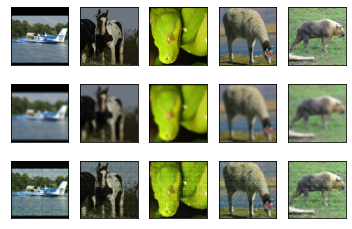

Epoch : [222/300] 

Training Loss: 0.002889	 validation Loss 0.004520
PNSR :20.07 	 SSIM : 0.75
PNSR :19.35 	 SSIM : 0.81
PNSR :20.72 	 SSIM : 0.67
PNSR :19.72 	 SSIM : 0.78
PNSR :18.42 	 SSIM : 0.73


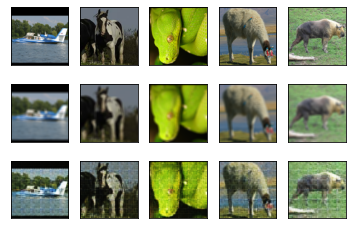

Epoch : [223/300] 

Training Loss: 0.002963	 validation Loss 0.003492
PNSR :22.28 	 SSIM : 0.81
PNSR :20.45 	 SSIM : 0.86
PNSR :23.93 	 SSIM : 0.73
PNSR :22.28 	 SSIM : 0.84
PNSR :20.58 	 SSIM : 0.79


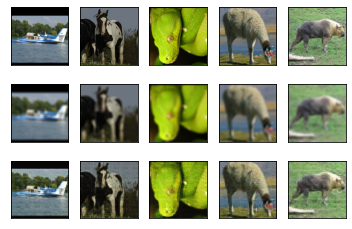

Epoch : [224/300] 

Training Loss: 0.002860	 validation Loss 0.004039
PNSR :21.61 	 SSIM : 0.78
PNSR :19.54 	 SSIM : 0.83
PNSR :22.74 	 SSIM : 0.71
PNSR :20.79 	 SSIM : 0.80
PNSR :19.50 	 SSIM : 0.76


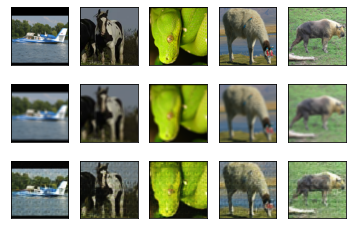

Epoch : [225/300] 

Training Loss: 0.002861	 validation Loss 0.004699
PNSR :20.68 	 SSIM : 0.74
PNSR :19.54 	 SSIM : 0.81
PNSR :22.90 	 SSIM : 0.67
PNSR :19.38 	 SSIM : 0.77
PNSR :18.85 	 SSIM : 0.72


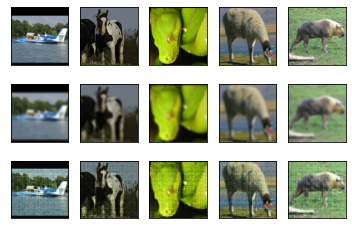

Epoch : [226/300] 

Training Loss: 0.002856	 validation Loss 0.003856
PNSR :22.51 	 SSIM : 0.80
PNSR :20.66 	 SSIM : 0.85
PNSR :24.46 	 SSIM : 0.73
PNSR :21.55 	 SSIM : 0.84
PNSR :20.01 	 SSIM : 0.78


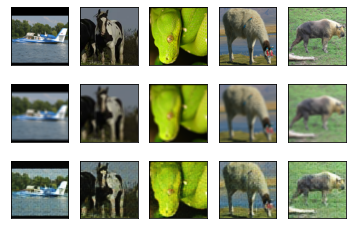

Epoch : [227/300] 

Training Loss: 0.002842	 validation Loss 0.003681
PNSR :21.54 	 SSIM : 0.81
PNSR :20.23 	 SSIM : 0.86
PNSR :23.12 	 SSIM : 0.74
PNSR :21.31 	 SSIM : 0.85
PNSR :20.18 	 SSIM : 0.79


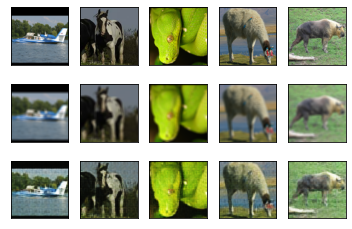

Epoch : [228/300] 

Training Loss: 0.002822	 validation Loss 0.004378
PNSR :21.31 	 SSIM : 0.77
PNSR :20.50 	 SSIM : 0.82
PNSR :22.96 	 SSIM : 0.71
PNSR :20.55 	 SSIM : 0.80
PNSR :20.08 	 SSIM : 0.76


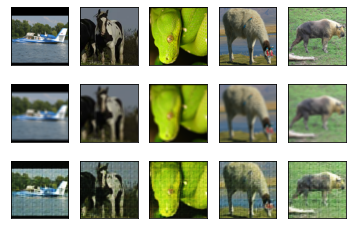

Epoch : [229/300] 

Training Loss: 0.002829	 validation Loss 0.003971
PNSR :22.47 	 SSIM : 0.79
PNSR :20.71 	 SSIM : 0.84
PNSR :24.47 	 SSIM : 0.70
PNSR :20.97 	 SSIM : 0.82
PNSR :19.71 	 SSIM : 0.77


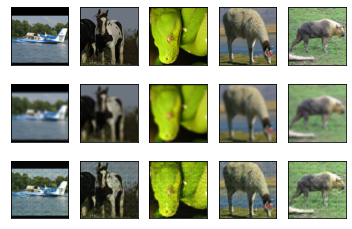

Epoch : [230/300] 

Training Loss: 0.002827	 validation Loss 0.003666
PNSR :21.45 	 SSIM : 0.80
PNSR :20.75 	 SSIM : 0.85
PNSR :23.94 	 SSIM : 0.73
PNSR :20.95 	 SSIM : 0.84
PNSR :19.68 	 SSIM : 0.79


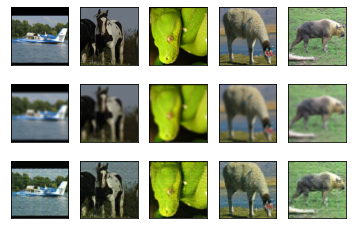

Epoch : [231/300] 

Training Loss: 0.002813	 validation Loss 0.004197
PNSR :20.92 	 SSIM : 0.78
PNSR :20.15 	 SSIM : 0.83
PNSR :22.60 	 SSIM : 0.72
PNSR :20.03 	 SSIM : 0.81
PNSR :19.80 	 SSIM : 0.76


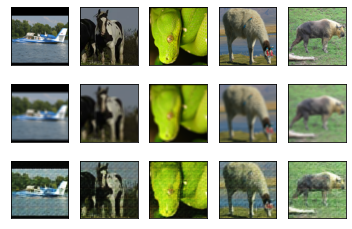

Epoch : [232/300] 

Training Loss: 0.002834	 validation Loss 0.003919
PNSR :21.25 	 SSIM : 0.79
PNSR :20.66 	 SSIM : 0.84
PNSR :22.93 	 SSIM : 0.71
PNSR :20.66 	 SSIM : 0.81
PNSR :20.00 	 SSIM : 0.76


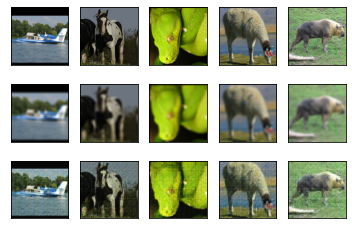

Epoch : [233/300] 

Training Loss: 0.002793	 validation Loss 0.004105
PNSR :21.70 	 SSIM : 0.79
PNSR :20.29 	 SSIM : 0.83
PNSR :23.43 	 SSIM : 0.71
PNSR :20.22 	 SSIM : 0.81
PNSR :19.45 	 SSIM : 0.76


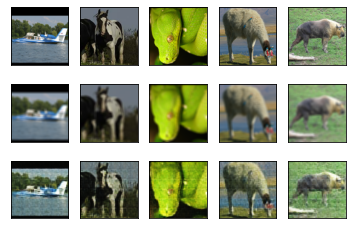

Epoch : [234/300] 

Training Loss: 0.002801	 validation Loss 0.003774
PNSR :22.57 	 SSIM : 0.80
PNSR :20.68 	 SSIM : 0.85
PNSR :24.11 	 SSIM : 0.73
PNSR :21.04 	 SSIM : 0.83
PNSR :20.29 	 SSIM : 0.78


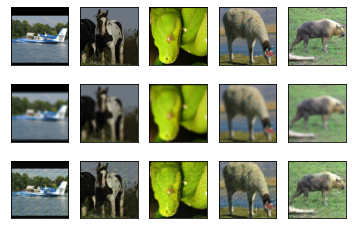

Epoch : [235/300] 

Training Loss: 0.002786	 validation Loss 0.004291
PNSR :22.24 	 SSIM : 0.77
PNSR :20.62 	 SSIM : 0.83
PNSR :23.55 	 SSIM : 0.70
PNSR :20.65 	 SSIM : 0.80
PNSR :19.65 	 SSIM : 0.75


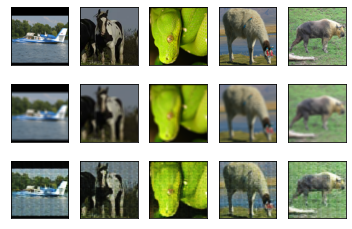

Epoch : [236/300] 

Training Loss: 0.002806	 validation Loss 0.004669
PNSR :21.51 	 SSIM : 0.75
PNSR :20.26 	 SSIM : 0.80
PNSR :22.36 	 SSIM : 0.66
PNSR :20.28 	 SSIM : 0.78
PNSR :19.56 	 SSIM : 0.73


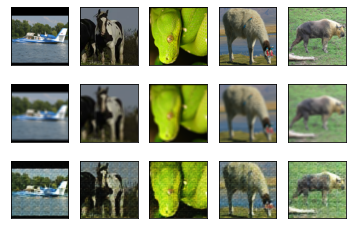

Epoch : [237/300] 

Training Loss: 0.002790	 validation Loss 0.003798
PNSR :22.89 	 SSIM : 0.80
PNSR :21.13 	 SSIM : 0.85
PNSR :24.37 	 SSIM : 0.71
PNSR :22.43 	 SSIM : 0.83
PNSR :21.04 	 SSIM : 0.78


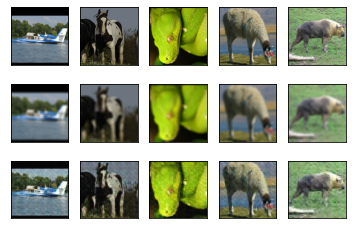

Epoch : [238/300] 

Training Loss: 0.002778	 validation Loss 0.004126
PNSR :21.79 	 SSIM : 0.79
PNSR :20.35 	 SSIM : 0.84
PNSR :22.75 	 SSIM : 0.71
PNSR :20.52 	 SSIM : 0.82
PNSR :19.61 	 SSIM : 0.77


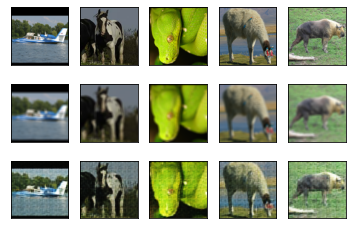

Epoch : [239/300] 

Training Loss: 0.002804	 validation Loss 0.004006
PNSR :21.07 	 SSIM : 0.79
PNSR :20.43 	 SSIM : 0.84
PNSR :22.38 	 SSIM : 0.71
PNSR :20.37 	 SSIM : 0.82
PNSR :19.63 	 SSIM : 0.77


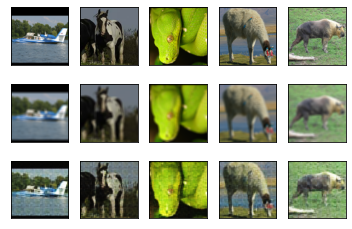

Epoch : [240/300] 

Training Loss: 0.002784	 validation Loss 0.003863
PNSR :22.33 	 SSIM : 0.80
PNSR :20.13 	 SSIM : 0.85
PNSR :23.82 	 SSIM : 0.71
PNSR :21.27 	 SSIM : 0.83
PNSR :20.18 	 SSIM : 0.77


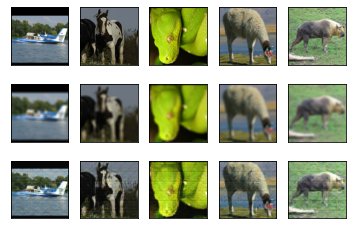

Epoch : [241/300] 

Training Loss: 0.002782	 validation Loss 0.003822
PNSR :21.88 	 SSIM : 0.81
PNSR :20.40 	 SSIM : 0.86
PNSR :23.19 	 SSIM : 0.73
PNSR :20.91 	 SSIM : 0.84
PNSR :19.97 	 SSIM : 0.79


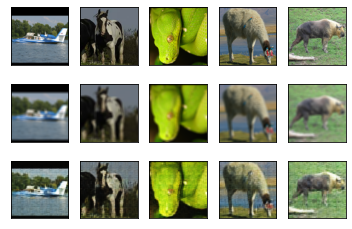

Epoch : [242/300] 

Training Loss: 0.002776	 validation Loss 0.003868
PNSR :22.73 	 SSIM : 0.80
PNSR :20.51 	 SSIM : 0.85
PNSR :24.61 	 SSIM : 0.71
PNSR :21.93 	 SSIM : 0.83
PNSR :20.31 	 SSIM : 0.78


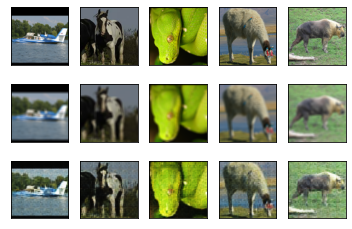

Epoch : [243/300] 

Training Loss: 0.002787	 validation Loss 0.003937
PNSR :22.67 	 SSIM : 0.80
PNSR :20.59 	 SSIM : 0.85
PNSR :24.58 	 SSIM : 0.71
PNSR :21.62 	 SSIM : 0.83
PNSR :20.24 	 SSIM : 0.78


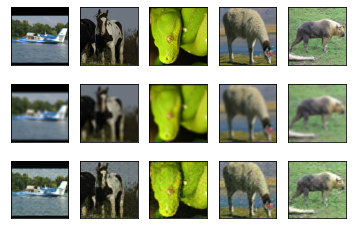

Epoch : [244/300] 

Training Loss: 0.002765	 validation Loss 0.004062
PNSR :22.69 	 SSIM : 0.79
PNSR :20.87 	 SSIM : 0.84
PNSR :24.48 	 SSIM : 0.71
PNSR :21.71 	 SSIM : 0.82
PNSR :20.26 	 SSIM : 0.77


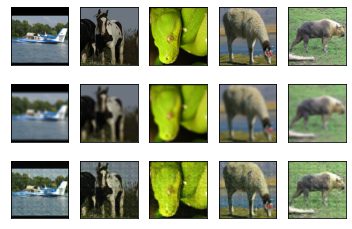

Epoch : [245/300] 

Training Loss: 0.002781	 validation Loss 0.004287
PNSR :22.52 	 SSIM : 0.78
PNSR :20.82 	 SSIM : 0.83
PNSR :24.40 	 SSIM : 0.69
PNSR :21.73 	 SSIM : 0.80
PNSR :20.12 	 SSIM : 0.75


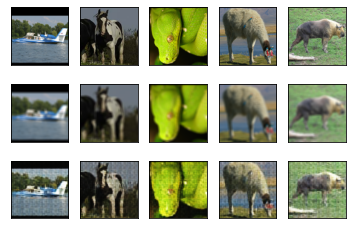

Epoch : [246/300] 

Training Loss: 0.002775	 validation Loss 0.004230
PNSR :21.72 	 SSIM : 0.77
PNSR :20.30 	 SSIM : 0.83
PNSR :22.84 	 SSIM : 0.69
PNSR :20.84 	 SSIM : 0.81
PNSR :18.92 	 SSIM : 0.75


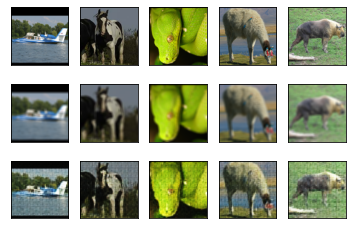

Epoch : [247/300] 

Training Loss: 0.002775	 validation Loss 0.003997
PNSR :22.51 	 SSIM : 0.79
PNSR :20.34 	 SSIM : 0.84
PNSR :24.94 	 SSIM : 0.71
PNSR :21.92 	 SSIM : 0.82
PNSR :20.42 	 SSIM : 0.77


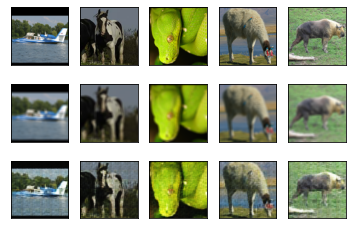

Epoch : [248/300] 

Training Loss: 0.002791	 validation Loss 0.003879
PNSR :21.87 	 SSIM : 0.79
PNSR :20.47 	 SSIM : 0.84
PNSR :23.83 	 SSIM : 0.72
PNSR :21.45 	 SSIM : 0.82
PNSR :20.61 	 SSIM : 0.77


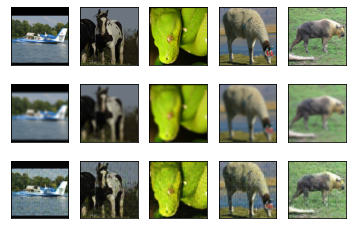

Epoch : [249/300] 

Training Loss: 0.002776	 validation Loss 0.004010
PNSR :21.24 	 SSIM : 0.79
PNSR :20.48 	 SSIM : 0.84
PNSR :22.81 	 SSIM : 0.71
PNSR :20.62 	 SSIM : 0.82
PNSR :19.44 	 SSIM : 0.77


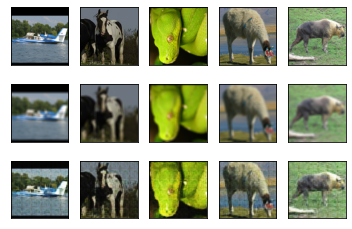

Epoch : [250/300] 

Training Loss: 0.002760	 validation Loss 0.003931
PNSR :22.58 	 SSIM : 0.80
PNSR :20.87 	 SSIM : 0.85
PNSR :24.07 	 SSIM : 0.73
PNSR :21.79 	 SSIM : 0.83
PNSR :20.24 	 SSIM : 0.78


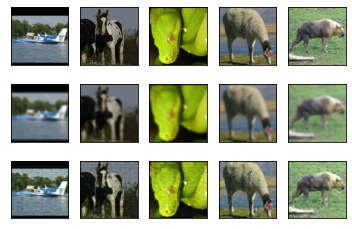

Epoch : [251/300] 

Training Loss: 0.002758	 validation Loss 0.004209
PNSR :21.13 	 SSIM : 0.78
PNSR :19.94 	 SSIM : 0.83
PNSR :22.19 	 SSIM : 0.70
PNSR :20.18 	 SSIM : 0.81
PNSR :19.06 	 SSIM : 0.76


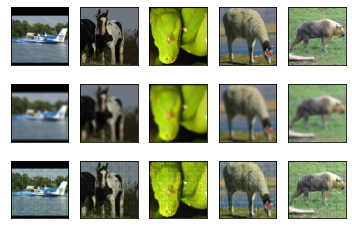

Epoch : [252/300] 

Training Loss: 0.002783	 validation Loss 0.003908
PNSR :21.87 	 SSIM : 0.78
PNSR :20.28 	 SSIM : 0.83
PNSR :23.33 	 SSIM : 0.69
PNSR :22.01 	 SSIM : 0.81
PNSR :20.51 	 SSIM : 0.76


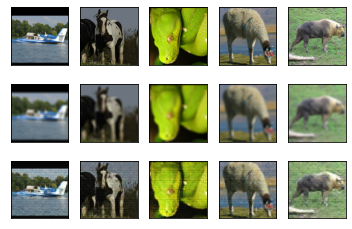

Epoch : [253/300] 

Training Loss: 0.002762	 validation Loss 0.003909
PNSR :22.16 	 SSIM : 0.80
PNSR :20.62 	 SSIM : 0.85
PNSR :24.04 	 SSIM : 0.71
PNSR :21.33 	 SSIM : 0.83
PNSR :20.11 	 SSIM : 0.78


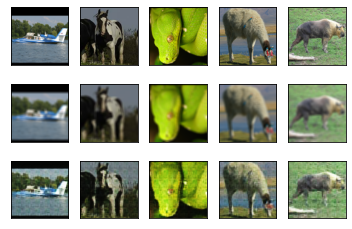

Epoch : [254/300] 

Training Loss: 0.002761	 validation Loss 0.004297
PNSR :20.73 	 SSIM : 0.78
PNSR :19.76 	 SSIM : 0.83
PNSR :22.66 	 SSIM : 0.71
PNSR :20.47 	 SSIM : 0.80
PNSR :19.54 	 SSIM : 0.75


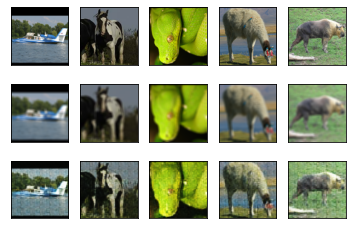

Epoch : [255/300] 

Training Loss: 0.002759	 validation Loss 0.004271
PNSR :21.76 	 SSIM : 0.79
PNSR :20.26 	 SSIM : 0.84
PNSR :22.74 	 SSIM : 0.71
PNSR :20.79 	 SSIM : 0.82
PNSR :19.66 	 SSIM : 0.77


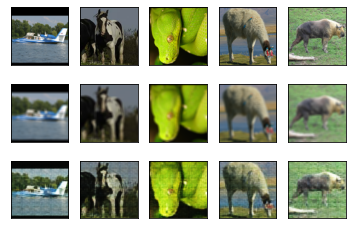

Epoch : [256/300] 

Training Loss: 0.002813	 validation Loss 0.005763
PNSR :18.81 	 SSIM : 0.68
PNSR :19.30 	 SSIM : 0.76
PNSR :21.07 	 SSIM : 0.62
PNSR :18.45 	 SSIM : 0.70
PNSR :16.73 	 SSIM : 0.64


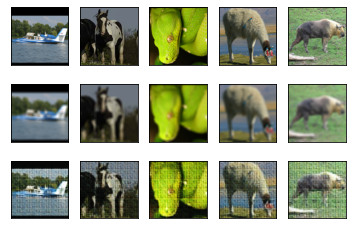

Epoch : [257/300] 

Training Loss: 0.002764	 validation Loss 0.004092
PNSR :21.17 	 SSIM : 0.79
PNSR :20.14 	 SSIM : 0.84
PNSR :23.54 	 SSIM : 0.71
PNSR :20.82 	 SSIM : 0.82
PNSR :19.81 	 SSIM : 0.77


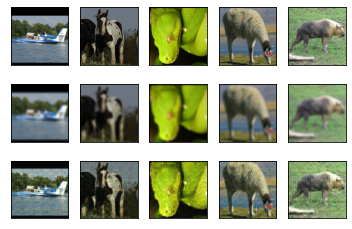

Epoch : [258/300] 

Training Loss: 0.002746	 validation Loss 0.004404
PNSR :20.57 	 SSIM : 0.78
PNSR :19.87 	 SSIM : 0.84
PNSR :22.22 	 SSIM : 0.70
PNSR :19.73 	 SSIM : 0.81
PNSR :18.97 	 SSIM : 0.76


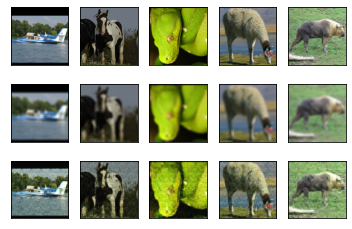

Epoch : [259/300] 

Training Loss: 0.002752	 validation Loss 0.004158
PNSR :21.90 	 SSIM : 0.79
PNSR :20.36 	 SSIM : 0.84
PNSR :22.70 	 SSIM : 0.71
PNSR :21.58 	 SSIM : 0.82
PNSR :19.90 	 SSIM : 0.76


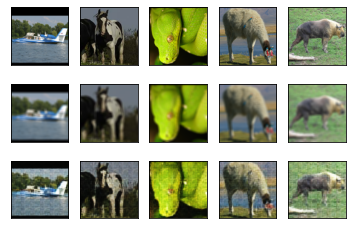

Epoch : [260/300] 

Training Loss: 0.002752	 validation Loss 0.004284
PNSR :21.33 	 SSIM : 0.79
PNSR :20.66 	 SSIM : 0.84
PNSR :24.29 	 SSIM : 0.71
PNSR :21.29 	 SSIM : 0.82
PNSR :19.97 	 SSIM : 0.77


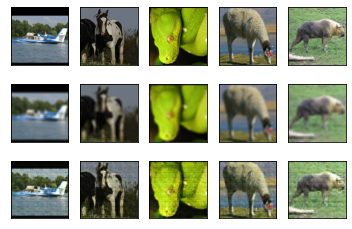

Epoch : [261/300] 

Training Loss: 0.002755	 validation Loss 0.004298
PNSR :20.93 	 SSIM : 0.77
PNSR :20.32 	 SSIM : 0.83
PNSR :22.62 	 SSIM : 0.70
PNSR :19.71 	 SSIM : 0.80
PNSR :18.92 	 SSIM : 0.75


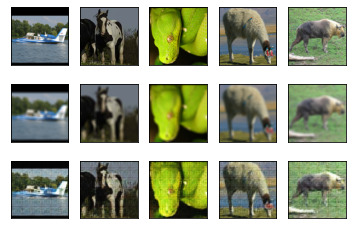

Epoch : [262/300] 

Training Loss: 0.002750	 validation Loss 0.003884
PNSR :22.70 	 SSIM : 0.80
PNSR :20.81 	 SSIM : 0.85
PNSR :23.80 	 SSIM : 0.71
PNSR :22.20 	 SSIM : 0.84
PNSR :20.62 	 SSIM : 0.79


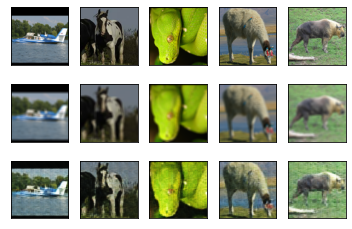

Epoch : [263/300] 

Training Loss: 0.002749	 validation Loss 0.004350
PNSR :21.98 	 SSIM : 0.78
PNSR :20.86 	 SSIM : 0.83
PNSR :23.24 	 SSIM : 0.70
PNSR :21.38 	 SSIM : 0.81
PNSR :19.91 	 SSIM : 0.75


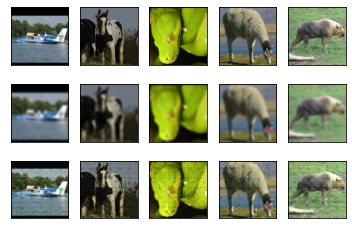

Epoch : [264/300] 

Training Loss: 0.002745	 validation Loss 0.004446
PNSR :20.70 	 SSIM : 0.78
PNSR :20.45 	 SSIM : 0.83
PNSR :22.02 	 SSIM : 0.70
PNSR :20.34 	 SSIM : 0.80
PNSR :19.49 	 SSIM : 0.75


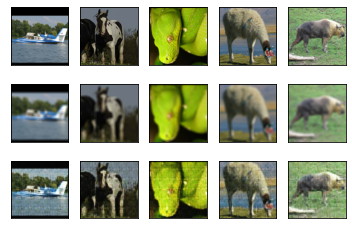

Epoch : [265/300] 

Training Loss: 0.002739	 validation Loss 0.004415
PNSR :20.85 	 SSIM : 0.77
PNSR :20.36 	 SSIM : 0.83
PNSR :22.75 	 SSIM : 0.71
PNSR :20.60 	 SSIM : 0.80
PNSR :19.75 	 SSIM : 0.75


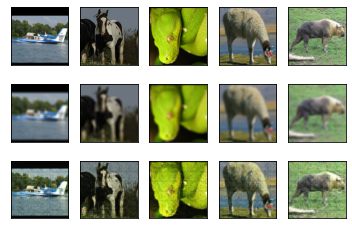

Epoch : [266/300] 

Training Loss: 0.002742	 validation Loss 0.004274
PNSR :21.80 	 SSIM : 0.79
PNSR :20.73 	 SSIM : 0.84
PNSR :22.89 	 SSIM : 0.71
PNSR :20.91 	 SSIM : 0.82
PNSR :19.90 	 SSIM : 0.77


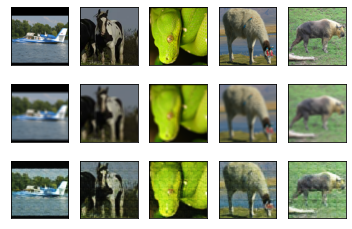

Epoch : [267/300] 

Training Loss: 0.002746	 validation Loss 0.004221
PNSR :22.25 	 SSIM : 0.77
PNSR :21.00 	 SSIM : 0.83
PNSR :24.17 	 SSIM : 0.71
PNSR :21.16 	 SSIM : 0.80
PNSR :19.81 	 SSIM : 0.75


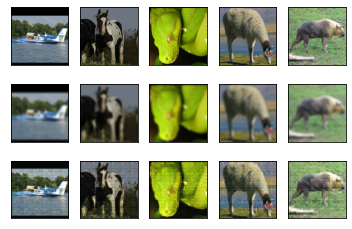

Epoch : [268/300] 

Training Loss: 0.002755	 validation Loss 0.003814
PNSR :22.54 	 SSIM : 0.80
PNSR :20.94 	 SSIM : 0.86
PNSR :24.72 	 SSIM : 0.73
PNSR :22.50 	 SSIM : 0.83
PNSR :20.56 	 SSIM : 0.79


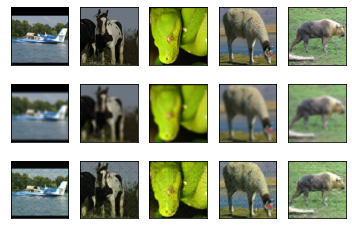

Epoch : [269/300] 

Training Loss: 0.002733	 validation Loss 0.003801
PNSR :22.18 	 SSIM : 0.81
PNSR :20.94 	 SSIM : 0.86
PNSR :24.11 	 SSIM : 0.72
PNSR :21.76 	 SSIM : 0.84
PNSR :20.23 	 SSIM : 0.78


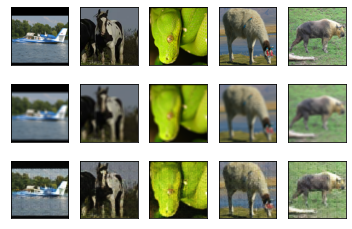

Epoch : [270/300] 

Training Loss: 0.002752	 validation Loss 0.004430
PNSR :22.14 	 SSIM : 0.77
PNSR :20.27 	 SSIM : 0.83
PNSR :23.83 	 SSIM : 0.71
PNSR :21.11 	 SSIM : 0.80
PNSR :19.71 	 SSIM : 0.75


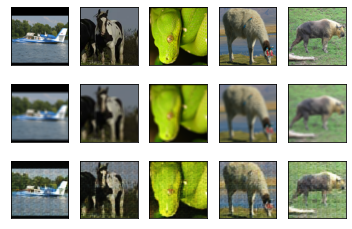

Epoch : [271/300] 

Training Loss: 0.002735	 validation Loss 0.004410
PNSR :21.23 	 SSIM : 0.78
PNSR :19.98 	 SSIM : 0.83
PNSR :22.07 	 SSIM : 0.69
PNSR :20.71 	 SSIM : 0.81
PNSR :19.24 	 SSIM : 0.76


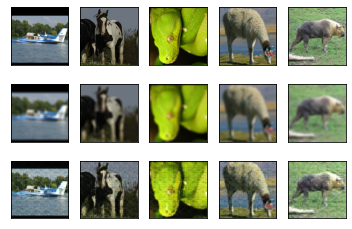

Epoch : [272/300] 

Training Loss: 0.002796	 validation Loss 0.004918
PNSR :21.02 	 SSIM : 0.76
PNSR :19.62 	 SSIM : 0.80
PNSR :22.15 	 SSIM : 0.68
PNSR :20.34 	 SSIM : 0.77
PNSR :19.59 	 SSIM : 0.74


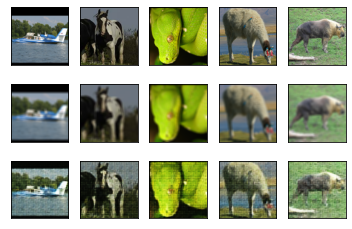

Epoch : [273/300] 

Training Loss: 0.002742	 validation Loss 0.004374
PNSR :22.32 	 SSIM : 0.77
PNSR :20.73 	 SSIM : 0.83
PNSR :23.94 	 SSIM : 0.69
PNSR :21.60 	 SSIM : 0.81
PNSR :20.41 	 SSIM : 0.75


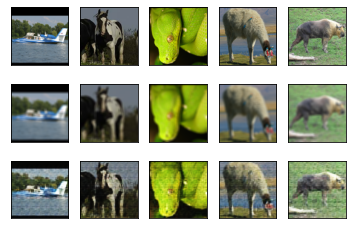

Epoch : [274/300] 

Training Loss: 0.002733	 validation Loss 0.004072
PNSR :21.30 	 SSIM : 0.79
PNSR :20.67 	 SSIM : 0.84
PNSR :23.06 	 SSIM : 0.71
PNSR :20.68 	 SSIM : 0.82
PNSR :19.49 	 SSIM : 0.77


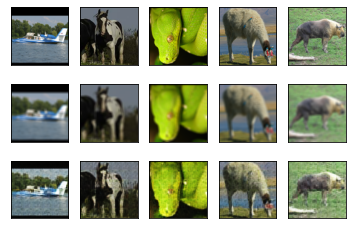

Epoch : [275/300] 

Training Loss: 0.002728	 validation Loss 0.004021
PNSR :22.59 	 SSIM : 0.81
PNSR :20.67 	 SSIM : 0.85
PNSR :24.31 	 SSIM : 0.73
PNSR :22.55 	 SSIM : 0.83
PNSR :20.95 	 SSIM : 0.78


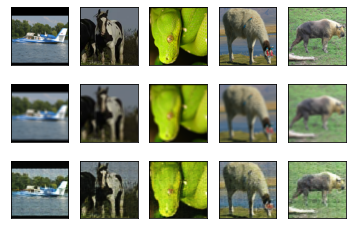

Epoch : [276/300] 

Training Loss: 0.002746	 validation Loss 0.004280
PNSR :22.14 	 SSIM : 0.77
PNSR :21.03 	 SSIM : 0.83
PNSR :23.59 	 SSIM : 0.70
PNSR :21.09 	 SSIM : 0.80
PNSR :20.12 	 SSIM : 0.75


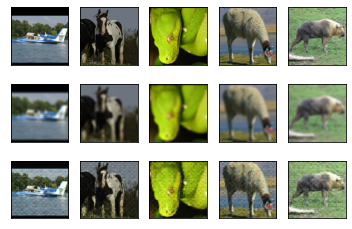

Epoch : [277/300] 

Training Loss: 0.002727	 validation Loss 0.004410
PNSR :21.17 	 SSIM : 0.77
PNSR :20.17 	 SSIM : 0.83
PNSR :22.90 	 SSIM : 0.70
PNSR :19.83 	 SSIM : 0.81
PNSR :19.03 	 SSIM : 0.75


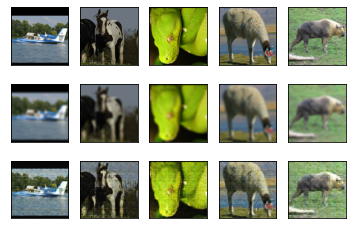

Epoch : [278/300] 

Training Loss: 0.002743	 validation Loss 0.004201
PNSR :22.37 	 SSIM : 0.80
PNSR :20.90 	 SSIM : 0.85
PNSR :24.19 	 SSIM : 0.71
PNSR :21.71 	 SSIM : 0.83
PNSR :20.60 	 SSIM : 0.78


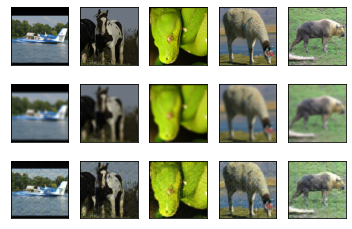

Epoch : [279/300] 

Training Loss: 0.002724	 validation Loss 0.004055
PNSR :20.94 	 SSIM : 0.80
PNSR :19.88 	 SSIM : 0.85
PNSR :23.26 	 SSIM : 0.72
PNSR :20.73 	 SSIM : 0.83
PNSR :19.65 	 SSIM : 0.78


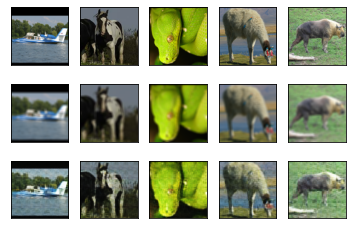

Epoch : [280/300] 

Training Loss: 0.002731	 validation Loss 0.003898
PNSR :22.02 	 SSIM : 0.80
PNSR :20.16 	 SSIM : 0.85
PNSR :23.28 	 SSIM : 0.73
PNSR :21.25 	 SSIM : 0.83
PNSR :20.13 	 SSIM : 0.78


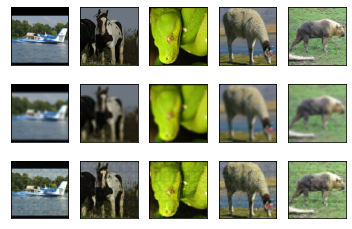

Epoch : [281/300] 

Training Loss: 0.002730	 validation Loss 0.004210
PNSR :22.20 	 SSIM : 0.79
PNSR :20.52 	 SSIM : 0.85
PNSR :24.11 	 SSIM : 0.71
PNSR :21.99 	 SSIM : 0.82
PNSR :20.36 	 SSIM : 0.76


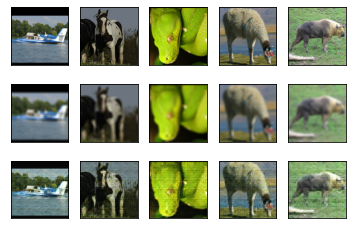

Epoch : [282/300] 

Training Loss: 0.002721	 validation Loss 0.004119
PNSR :22.25 	 SSIM : 0.78
PNSR :20.70 	 SSIM : 0.84
PNSR :23.60 	 SSIM : 0.70
PNSR :20.72 	 SSIM : 0.81
PNSR :19.78 	 SSIM : 0.76


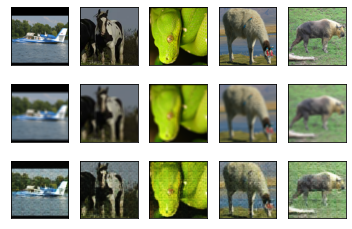

Epoch : [283/300] 

Training Loss: 0.002733	 validation Loss 0.004514
PNSR :20.54 	 SSIM : 0.78
PNSR :19.50 	 SSIM : 0.83
PNSR :22.20 	 SSIM : 0.69
PNSR :19.78 	 SSIM : 0.80
PNSR :18.85 	 SSIM : 0.74


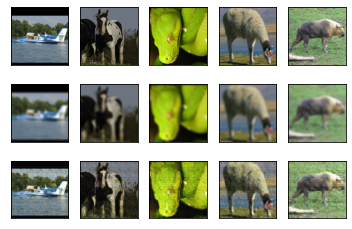

Epoch : [284/300] 

Training Loss: 0.002723	 validation Loss 0.004894
PNSR :20.56 	 SSIM : 0.78
PNSR :19.85 	 SSIM : 0.83
PNSR :22.62 	 SSIM : 0.69
PNSR :19.68 	 SSIM : 0.81
PNSR :18.94 	 SSIM : 0.76


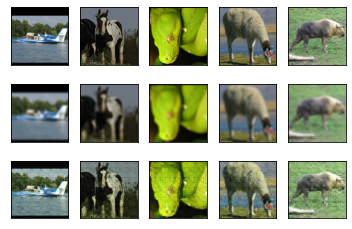

Epoch : [285/300] 

Training Loss: 0.002728	 validation Loss 0.004070
PNSR :22.52 	 SSIM : 0.78
PNSR :20.58 	 SSIM : 0.84
PNSR :23.41 	 SSIM : 0.72
PNSR :21.66 	 SSIM : 0.81
PNSR :20.32 	 SSIM : 0.77


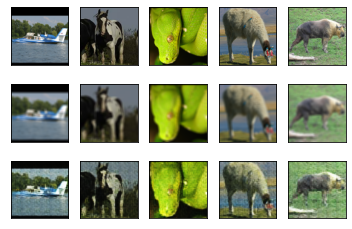

Epoch : [286/300] 

Training Loss: 0.002736	 validation Loss 0.004633
PNSR :21.25 	 SSIM : 0.77
PNSR :19.98 	 SSIM : 0.83
PNSR :22.15 	 SSIM : 0.67
PNSR :20.00 	 SSIM : 0.80
PNSR :18.56 	 SSIM : 0.75


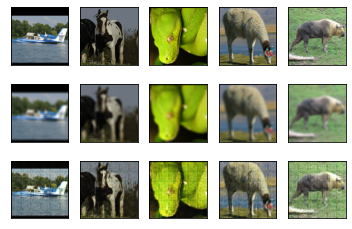

Epoch : [287/300] 

Training Loss: 0.002732	 validation Loss 0.004196
PNSR :21.10 	 SSIM : 0.79
PNSR :20.08 	 SSIM : 0.84
PNSR :21.80 	 SSIM : 0.70
PNSR :19.87 	 SSIM : 0.81
PNSR :18.69 	 SSIM : 0.76


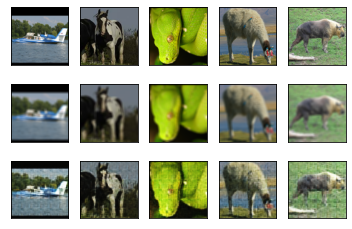

Epoch : [288/300] 

Training Loss: 0.002746	 validation Loss 0.004946
PNSR :20.37 	 SSIM : 0.76
PNSR :19.70 	 SSIM : 0.81
PNSR :20.69 	 SSIM : 0.67
PNSR :19.88 	 SSIM : 0.78
PNSR :18.37 	 SSIM : 0.73


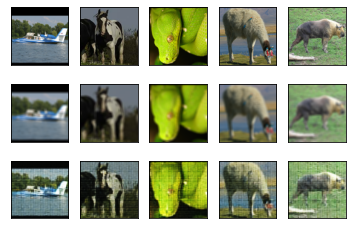

Epoch : [289/300] 

Training Loss: 0.005985	 validation Loss 0.037879
PNSR :13.23 	 SSIM : 0.54
PNSR :13.92 	 SSIM : 0.52
PNSR :12.20 	 SSIM : 0.50
PNSR :11.33 	 SSIM : 0.49
PNSR :10.66 	 SSIM : 0.42


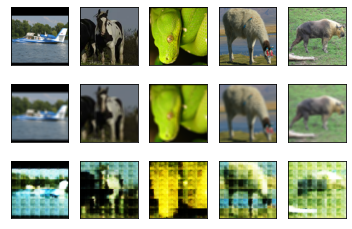

Epoch : [290/300] 

Training Loss: 0.004701	 validation Loss 0.006167
PNSR :19.81 	 SSIM : 0.70
PNSR :17.99 	 SSIM : 0.74
PNSR :20.76 	 SSIM : 0.63
PNSR :20.09 	 SSIM : 0.71
PNSR :17.65 	 SSIM : 0.67


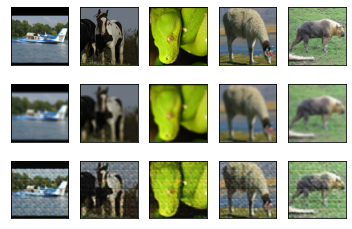

Epoch : [291/300] 

Training Loss: 0.003875	 validation Loss 0.005211
PNSR :21.20 	 SSIM : 0.73
PNSR :19.28 	 SSIM : 0.78
PNSR :22.66 	 SSIM : 0.65
PNSR :21.01 	 SSIM : 0.76
PNSR :19.13 	 SSIM : 0.70


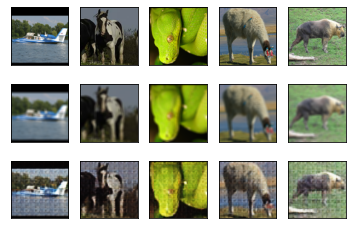

Epoch : [292/300] 

Training Loss: 0.003527	 validation Loss 0.004630
PNSR :20.70 	 SSIM : 0.75
PNSR :18.83 	 SSIM : 0.80
PNSR :22.70 	 SSIM : 0.67
PNSR :19.53 	 SSIM : 0.78
PNSR :18.53 	 SSIM : 0.73


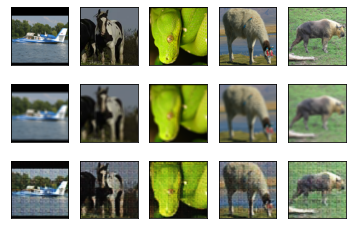

Epoch : [293/300] 

Training Loss: 0.003269	 validation Loss 0.004373
PNSR :21.08 	 SSIM : 0.75
PNSR :19.55 	 SSIM : 0.80
PNSR :22.51 	 SSIM : 0.66
PNSR :19.51 	 SSIM : 0.78
PNSR :18.95 	 SSIM : 0.72


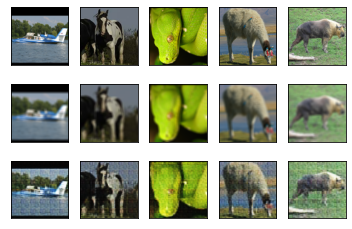

Epoch : [294/300] 

Training Loss: 0.003130	 validation Loss 0.003956
PNSR :21.90 	 SSIM : 0.78
PNSR :20.01 	 SSIM : 0.82
PNSR :23.10 	 SSIM : 0.68
PNSR :21.07 	 SSIM : 0.80
PNSR :19.97 	 SSIM : 0.75


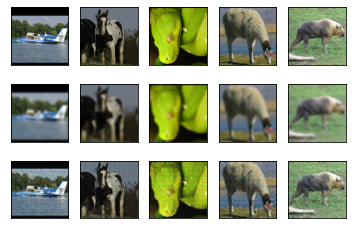

Epoch : [295/300] 

Training Loss: 0.003096	 validation Loss 0.004213
PNSR :21.62 	 SSIM : 0.76
PNSR :19.65 	 SSIM : 0.80
PNSR :22.09 	 SSIM : 0.67
PNSR :20.80 	 SSIM : 0.78
PNSR :19.39 	 SSIM : 0.73


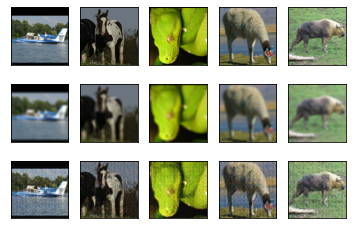

Epoch : [296/300] 

Training Loss: 0.003020	 validation Loss 0.004105
PNSR :21.66 	 SSIM : 0.77
PNSR :19.31 	 SSIM : 0.82
PNSR :22.41 	 SSIM : 0.67
PNSR :21.40 	 SSIM : 0.80
PNSR :19.91 	 SSIM : 0.75


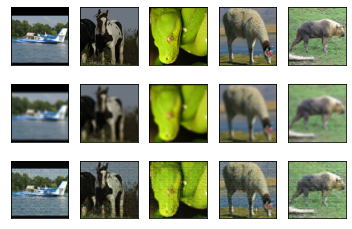

Epoch : [297/300] 

Training Loss: 0.002986	 validation Loss 0.003772
PNSR :22.11 	 SSIM : 0.79
PNSR :20.06 	 SSIM : 0.84
PNSR :22.89 	 SSIM : 0.70
PNSR :22.34 	 SSIM : 0.82
PNSR :20.73 	 SSIM : 0.78


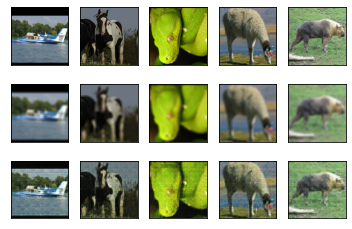

Epoch : [298/300] 

Training Loss: 0.002932	 validation Loss 0.003463
PNSR :22.81 	 SSIM : 0.81
PNSR :20.07 	 SSIM : 0.85
PNSR :23.56 	 SSIM : 0.71
PNSR :23.02 	 SSIM : 0.85
PNSR :21.06 	 SSIM : 0.79


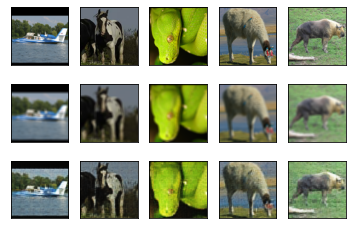

Epoch : [299/300] 

Training Loss: 0.002926	 validation Loss 0.003770
PNSR :22.68 	 SSIM : 0.80
PNSR :19.97 	 SSIM : 0.84
PNSR :24.03 	 SSIM : 0.71
PNSR :22.93 	 SSIM : 0.83
PNSR :21.25 	 SSIM : 0.78


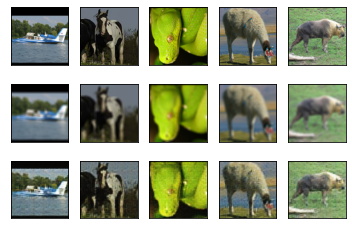

Epoch : [300/300] 

Training Loss: 0.002909	 validation Loss 0.003640
PNSR :22.88 	 SSIM : 0.81
PNSR :20.26 	 SSIM : 0.85
PNSR :23.69 	 SSIM : 0.71
PNSR :23.24 	 SSIM : 0.84
PNSR :21.11 	 SSIM : 0.78


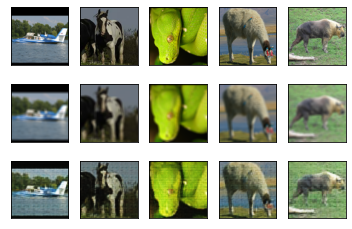

execution time : 372.9min


In [23]:

n_epochs = 300

device = get_device()
print(device)

model_moderate = DenosingAutoencoder()
optimizer_moderate = torch.optim.Adam(model_moderate.parameters(), lr=0.001, weight_decay  = 1e-04)
model_moderate=model_moderate.to(device)

moderate_train_loss_graph = np.array([])
moderate_val_loss_graph = np.array([])




start = time.time()

for epoch in range(1, n_epochs+1):
    print(f"Epoch : [{epoch}/{n_epochs}]","\n")
    model_moderate.train()
    # monitor training loss
    train_loss = 0.0
    total_train_loss = 0.0
    val_loss = 0.0
    total_val_loss = 0.0

    '''
    Total되는 새로운 변수를 하나 만들어줘야지 val_loss가 제대로 더해진다. 안 하면 이상하게 안 더해진다.
    '''
    #Training
    for i,(tr_img, hat_img) in enumerate(zip(tr_dataloader,moderate_hat_tr_dataloader)):
        tr_images,_ = tr_img
#        print(tr_images_arr.shape)
        hat_tr_images,_ = hat_img
#check   print(type(hat_tr_images))
        hat_tr_images = hat_tr_images.to(device) #데이터 형식이 Byte이기 때문에 신경망 성분인 float으로 변환해야 한다.
#check   print(tr_images.shape)
        tr_outputs =model_moderate(hat_tr_images)
        optimizer_moderate.zero_grad()
#check0. print(hat_tr_images.shape)  
#check   print(tr_outputs.shape)
        tr_images = tr_images.to(device)
        loss = mse_loss(tr_outputs, tr_images).to(device) #여기에 쿠다를 부착하니 성능 급 상승함.
        loss.backward()#.to(device)
        optimizer_moderate.step()
        train_loss = loss.clone().detach().item()
        total_train_loss += train_loss

#check1.        print(f"minibatch : {i}, train_loss_added : {total_train_loss/1250}")
    total_train_loss = total_train_loss/len(tr_dataloader)
    moderate_train_loss_graph = np.append(moderate_train_loss_graph, total_train_loss)

    
    #evaluation
    model_moderate.eval()
    with torch.no_grad():   
        optimizer_moderate.zero_grad()
        
        for i, (img, hat_img) in enumerate(zip(val_dataloader, moderate_hat_val_dataloader)):
                val_img, _ = img
                hat_val_img,_ = hat_img
                 
                hat_val_img = hat_val_img.to(device)
                val_outputs =model_moderate(hat_val_img)
#                print('val_outputs shape:',val_outputs.shape )
                val_img = val_img.to(device)
                val_loss = mse_loss(val_outputs, val_img)#.to(device)
                val_loss = val_loss.detach().item()
                total_val_loss += val_loss
#check2.     print(f"val_mini_batch : {i }, val_loss_added : {total_val_loss/313}")                
        total_val_loss = total_val_loss/len(val_dataloader)
        moderate_val_loss_graph = np.append(moderate_val_loss_graph, total_val_loss)
        print('Training Loss: {:.6f}\t validation Loss {:.6f}'.format(total_train_loss, total_val_loss))
          
#check3.     
        if (epoch)%1 == 0:

          for j in range(5):
            val_ssim = ssim(val_img[j].cpu().numpy().transpose(1, 2, 0), val_outputs[j].cpu().numpy().transpose(1, 2, 0), multichannel=True, gaussian_weights=True, use_sample_covariance=False)
            val_psnr = Get_psnr(val_img[j], val_outputs[j])
            print('PNSR :{:.2f} \t SSIM : {:.2f}'.format(val_psnr,val_ssim))
            
            ax = plt.subplot(3,5,j+1)
            plt.imshow(val_img[j].cpu().numpy().transpose(1, 2, 0))
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)


            ax = plt.subplot(3,5,j+5+1)
            plt.imshow(hat_val_img[j].cpu().numpy().transpose(1, 2, 0))
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)


            ax = plt.subplot(3, 5, j+5+5+1)
            plt.imshow(val_outputs[j].cpu().numpy().transpose(1, 2, 0))
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

          plt.show()   

end = time.time()

total_time = (end-start)/60
print("execution time : {:.1f}min".format(total_time))

train모드를 eval로 잠깐 만들었음. 훈련 시간 너무 오래 걸려서 그랬다. 다시 돌려놔야 한다.


# moderate test

# moderate graph

# test graph for (average psnr, ssim)

In [24]:
from skimage.metrics import structural_similarity as ssim

sum_ssim = 0.0
sum_psnr = 0.0
avg_ssim = 0.0
avg_psnr = 0.0

model_moderate.eval()
with torch.no_grad():
    optimizer_moderate.zero_grad()
    for i, (test_img, hat_test_img) in enumerate(zip(test_dataloader, Gs_blur_moderate_test_dataloader)):
        
        moderate_test_img, _ = test_img
        moderate_test_img = moderate_test_img.to(device)
        moderate_test_hat_img, _ = hat_test_img
        moderate_test_hat_img = moderate_test_hat_img.to(device)

        test_outputs = model_moderate(moderate_test_hat_img)
        
    for j in range(10):
        img1_cpu = moderate_test_img[j].cpu().numpy().transpose(1, 2, 0)
        img1_float64 = img1_cpu.astype(np.float64)
        img2_cpu = test_outputs[j].cpu().numpy()
        img2_float64 = img2_cpu.astype(np.float64).transpose(1, 2, 0)
        
        moderate_ssim = ssim(img1_float64, img2_float64, multichannel=True, gaussian_weights=True)
        moderate_psnr = Get_psnr(moderate_test_img[j], test_outputs[j], max_val = 1.0)
        sum_psnr+=moderate_psnr
        sum_ssim+=moderate_ssim
        print('PNSR :{:.2f} \t SSIM : {:.2f}'.format(moderate_psnr,moderate_ssim))
        
        ax = plt.subplot(3,10,j+1)
        plt.imshow(moderate_test_img[j].cpu().numpy().transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)


        ax = plt.subplot(3,10,j+10+1)
        plt.imshow(moderate_test_hat_img[j].cpu().numpy().transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)


        ax = plt.subplot(3,10, j+20+1)
        plt.imshow(test_outputs[j].cpu().detach().numpy().transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.show()   
avg_psnr=sum_psnr/10
avg_ssim=sum_ssim/10

print("avg_psnr : {:.2f}".format(avg_psnr))
print("avg_ssim : {:.2f}".format(avg_ssim))


NameError: ignored

In [ ]:
data = iter(Gs_blur_moderate_val_dataloader)
img,_ = next(data)
img_uint8 = img[0].numpy().astype('uint8')

plt.imshow(img_uint8.transpose(1,2,0))
img[0]

In [ ]:
print(img[0].shape)